<a href="https://colab.research.google.com/github/Pippi51/WSB-Dawid-Szwarc/blob/main/UczenieMaszynowe_Cwiczenia2_Zadania_202303.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Data set generation
import numpy as np
import matplotlib.pyplot as plt
import random

from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import SGD, Adam

# Generate 3 dimensional dataset with 10 classes and 250 elements
def generate_dataset():
    X = []
    y = []
    means = [[1, 1, 1], [2, 2, 2], [-1, -1, -1], [-2, -2, -2], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0]]
    covs = [[[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]]]
    for i in range(10):
        if i < 2:
            t = np.linspace(0, 2 * np.pi, 1000) + i * np.pi / 5
            x = np.sin(t) * t
            y_ = np.cos(t) * t
            z = np.zeros(1000)  # Add a third dimension filled with zeros
            X_class = np.column_stack((x, y_, z))
        elif i < 4:
            X_class = np.random.multivariate_normal(means[i], covs[i], 1000)
        elif i < 6:
            x, y_, z = np.random.randn(3, 1000)
            X_class = np.column_stack((x, y_, z))
        elif i < 8:
            X_class = np.random.randn(1000, 3)
        else:
            x, y_, z = np.random.randn(3, 1000) * 2
            X_class = np.column_stack((x, y_, z))
        if i == 0:
            X = X_class
            y = np.array([i] * 1000)
        else:
            X = np.concatenate((X, X_class), axis=0)
            y = np.concatenate((y, np.array([i] * 1000)), axis=0)
    return X, y




In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
def plot_dataset(X, y):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    for i in range(10):
        X_class = X[y == i]
        ax.scatter(X_class[:, 0], X_class[:, 1], X_class[:, 2], label='Class {}'.format(i))
    ax.legend()
    plt.show()


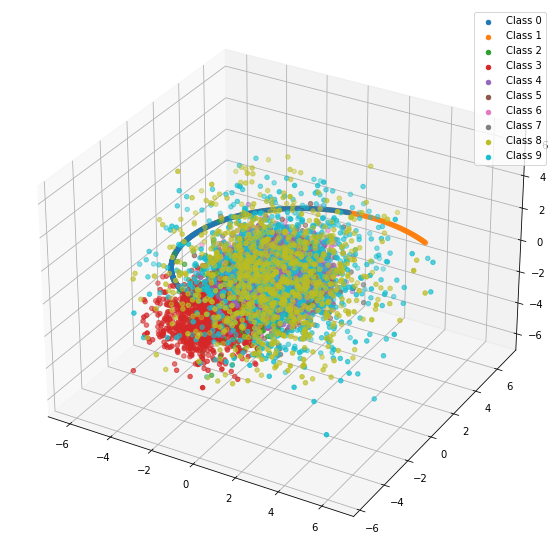

In [ ]:
(x, y) = generate_dataset()
plot_dataset(x, y)

In [ ]:
# Keras model class
class Classifier:
    def __init__(self, num_layers, neurons_per_layer, activation):
        self.num_layers = num_layers
        self.neurons_per_layer = neurons_per_layer
        self.activation = activation

    def build_model(self, input_shape):
        model = Sequential()
        model.add(Dense(self.neurons_per_layer, activation=self.activation, input_shape=(input_shape,)))
        for i in range(self.num_layers - 1):
            model.add(Dense(self.neurons_per_layer, activation=self.activation))
        model.add(Dense(10, activation='softmax'))
        return model

In [ ]:
# Train the model
def train(X, y, model, optimizer, epochs):
    model.compile(loss='sparse_categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    history = model.fit(X, y, epochs=epochs, verbose=0)
    return history

In [ ]:
# Plot the training results
def plot_history(history):
    plt.plot(history.history['accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.show()

In [ ]:
def plot_classification_results(X, y, model):
    y_probs = model.predict(X)
    y_pred = np.argmax(y_probs, axis=1)
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    for i in range(5):
        X_class = X[y == i]
        y_pred_class = y_pred[y == i]
        X_class_3d = np.column_stack((X_class, np.zeros(len(X_class)))) # add a third dimension
        ax.scatter(X_class_3d[:, 0], X_class_3d[:, 1], X_class_3d[:, 2], c=y_pred_class,
                   label='Class {}'.format(i))
    ax.legend()
    plt.show()

In [ ]:
# Main function
def experiment(num_layers=3, neurons_per_layer=32, activation='relu', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

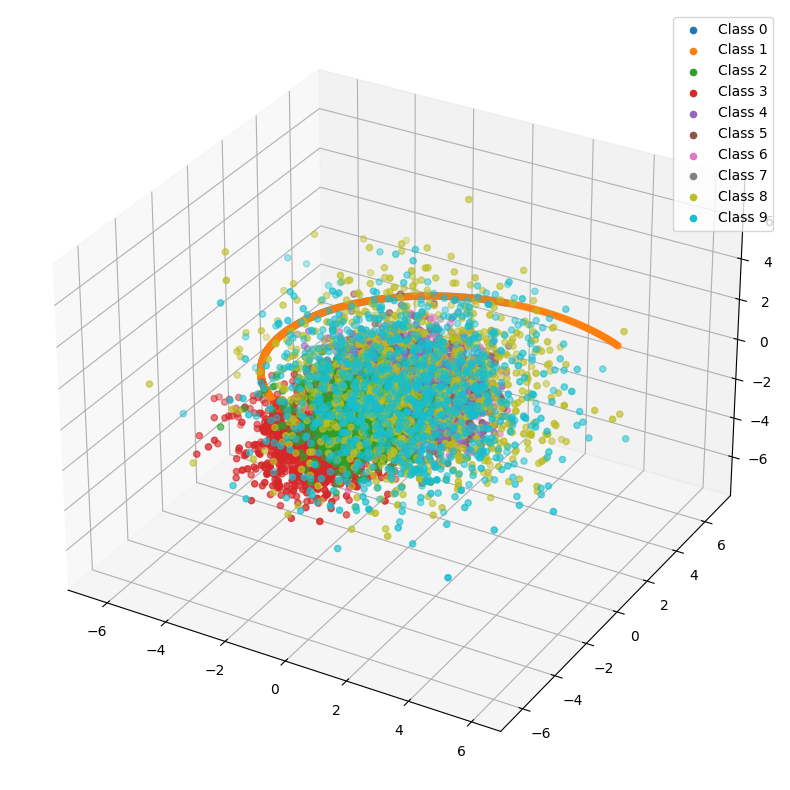

/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


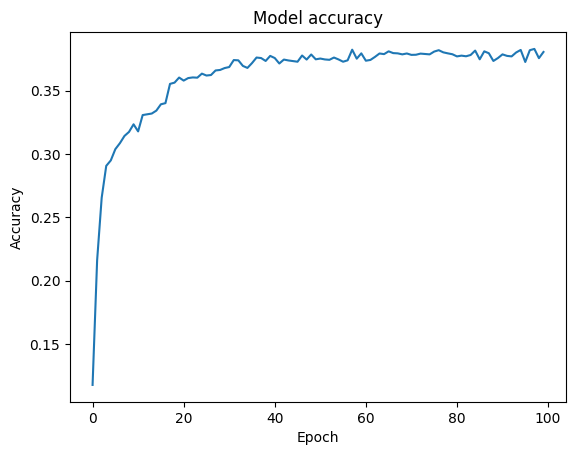

313/313 [==============================] - 0s 1ms/step


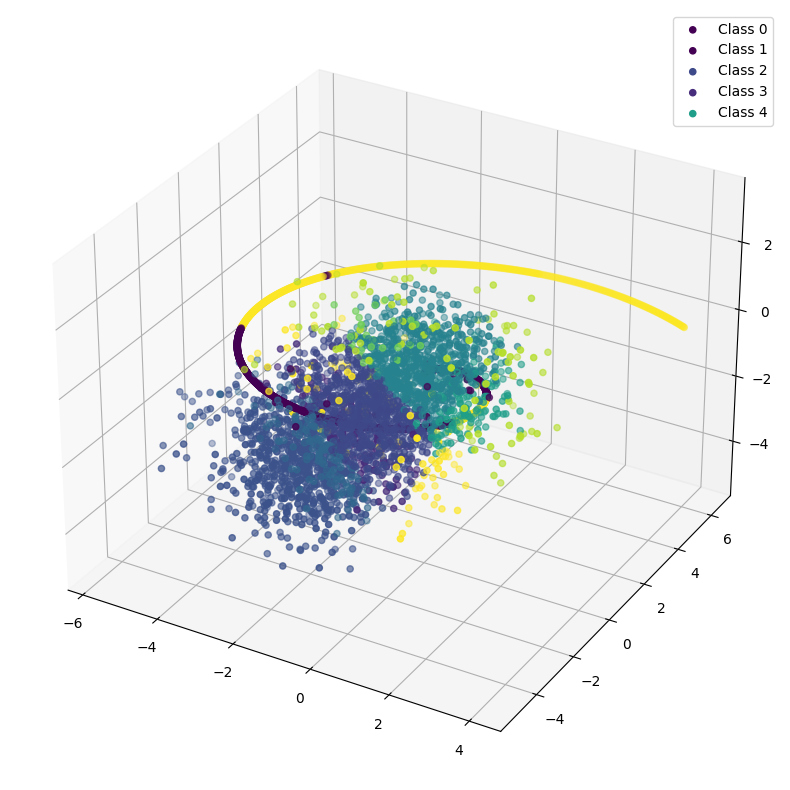

In [ ]:
experiment(4, 6)

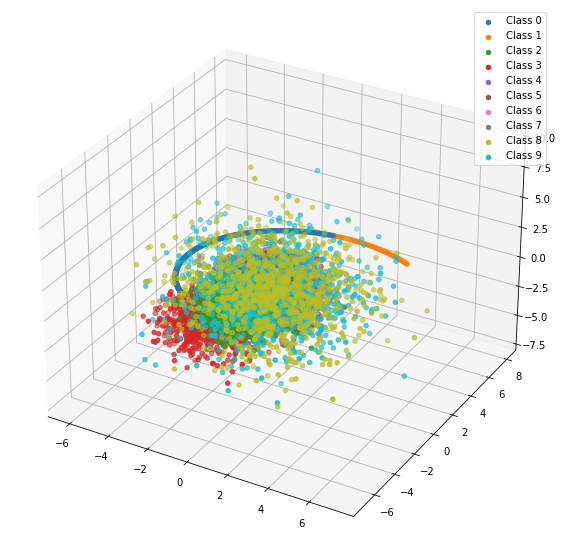

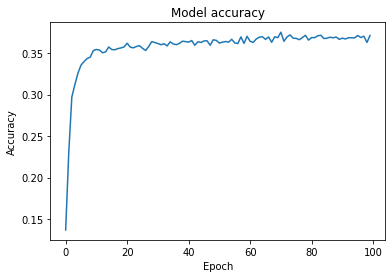

313/313 [==============================] - 0s 940us/step


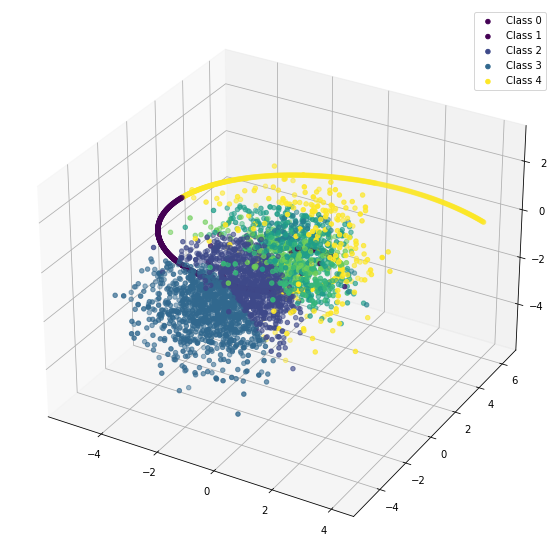

In [ ]:
experiment(4, 6)

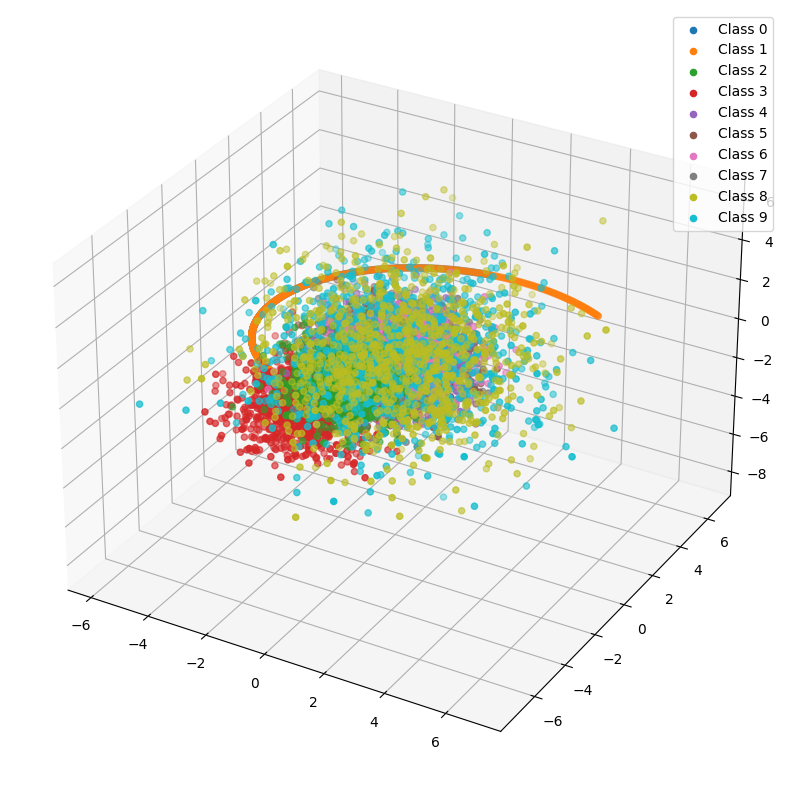

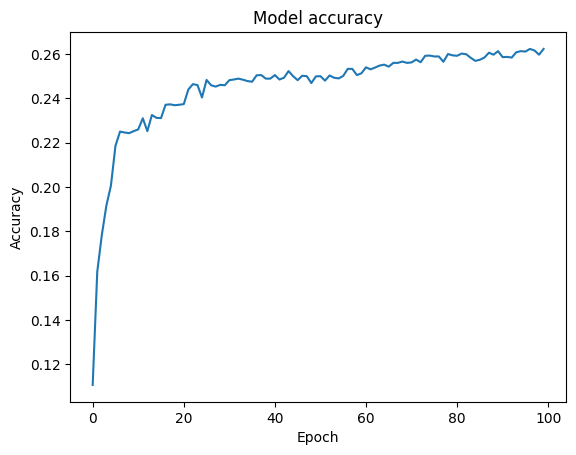

313/313 [==============================] - 1s 3ms/step


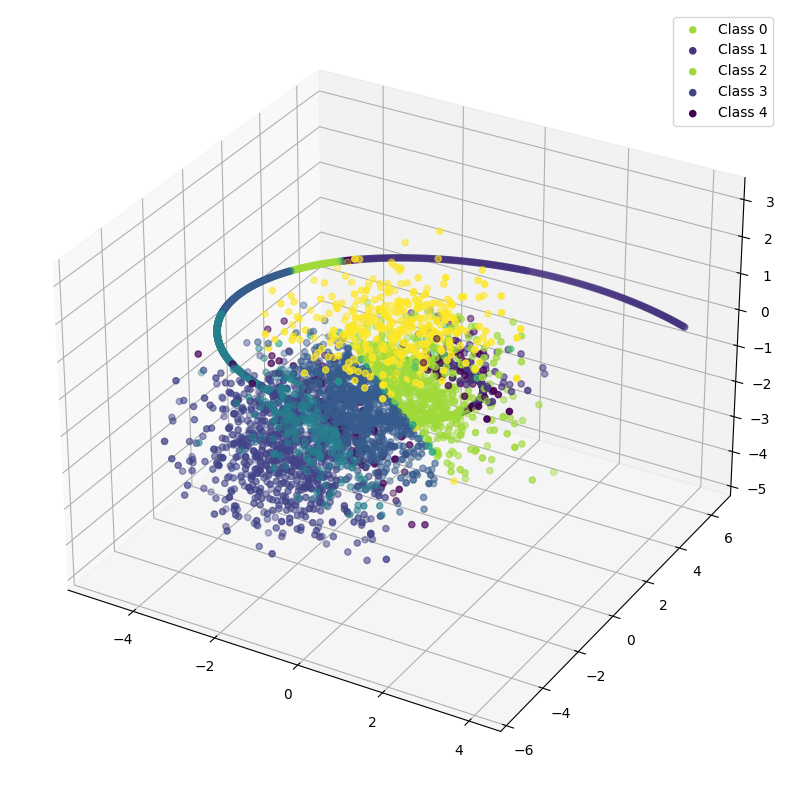

In [ ]:
experiment(2, 2)

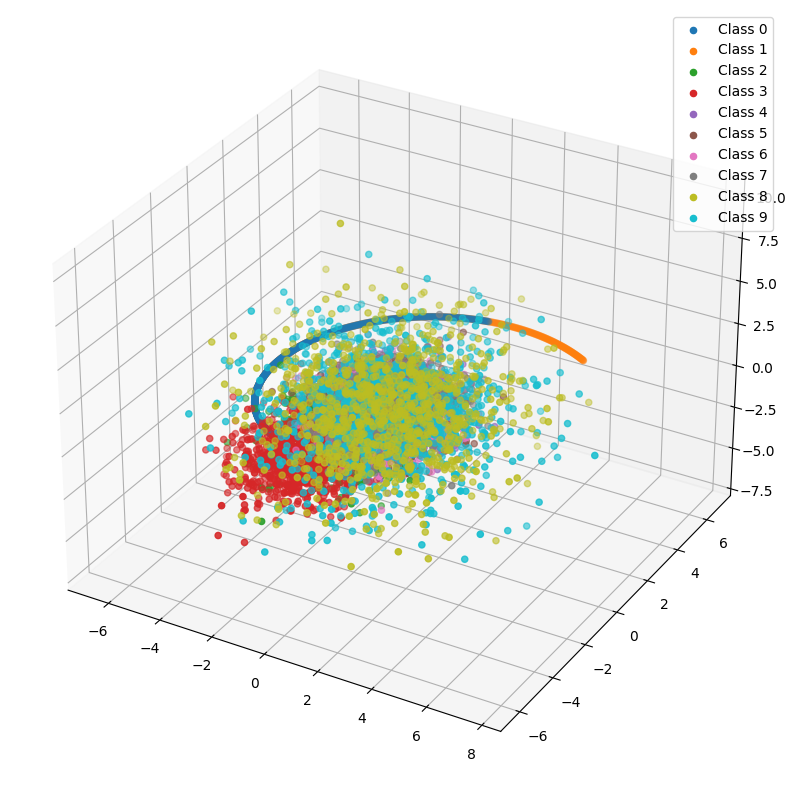

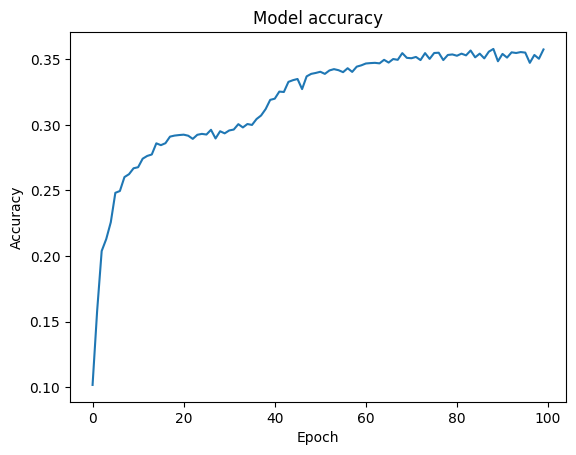

313/313 [==============================] - 1s 2ms/step


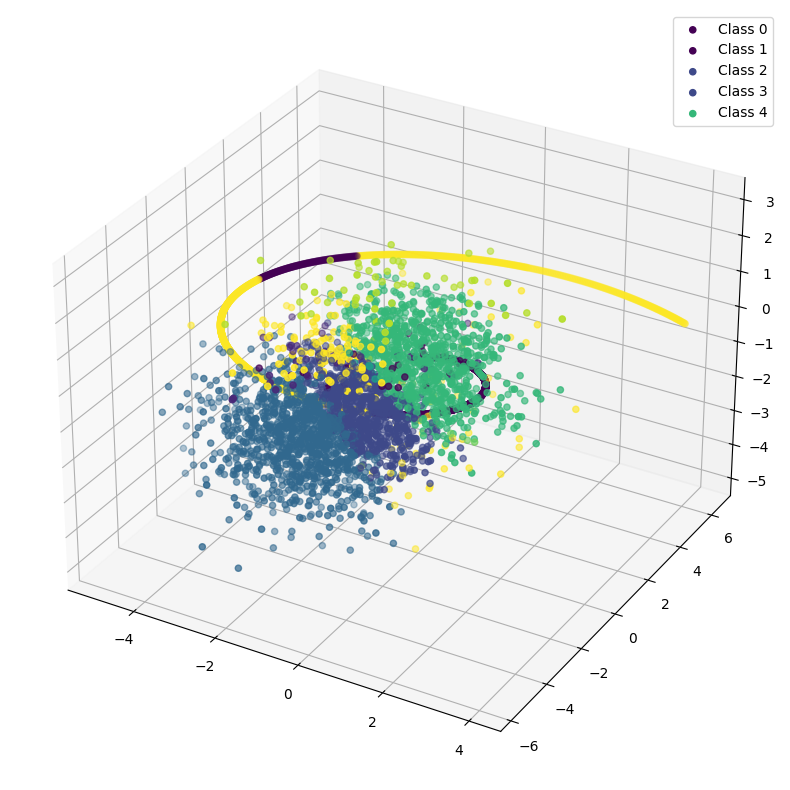

In [ ]:
experiment(2, 4)

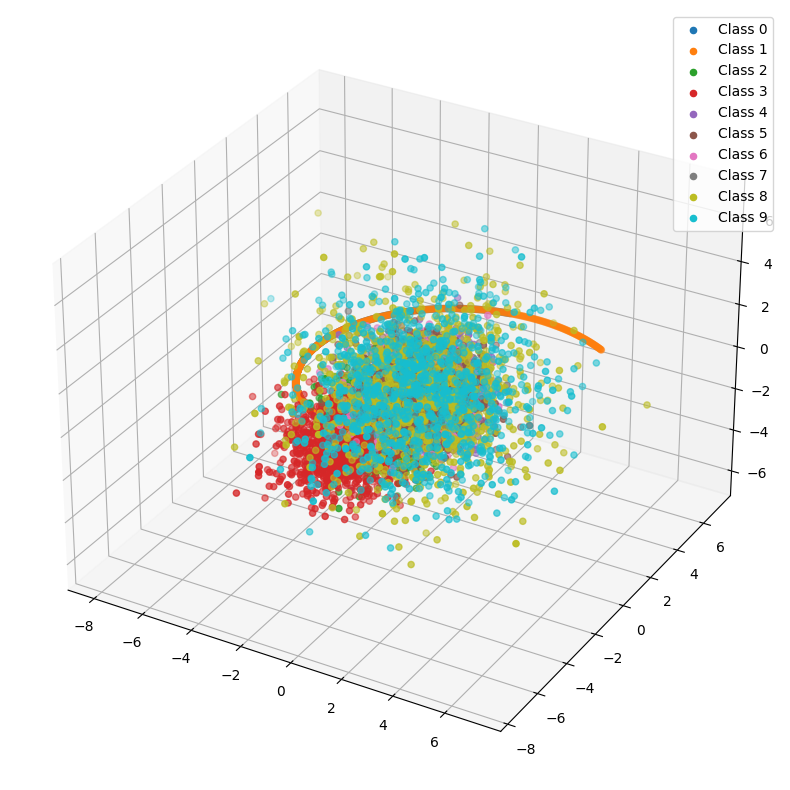

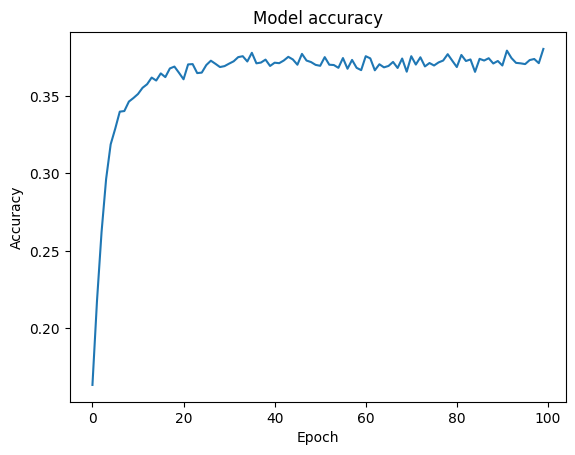

313/313 [==============================] - 1s 2ms/step


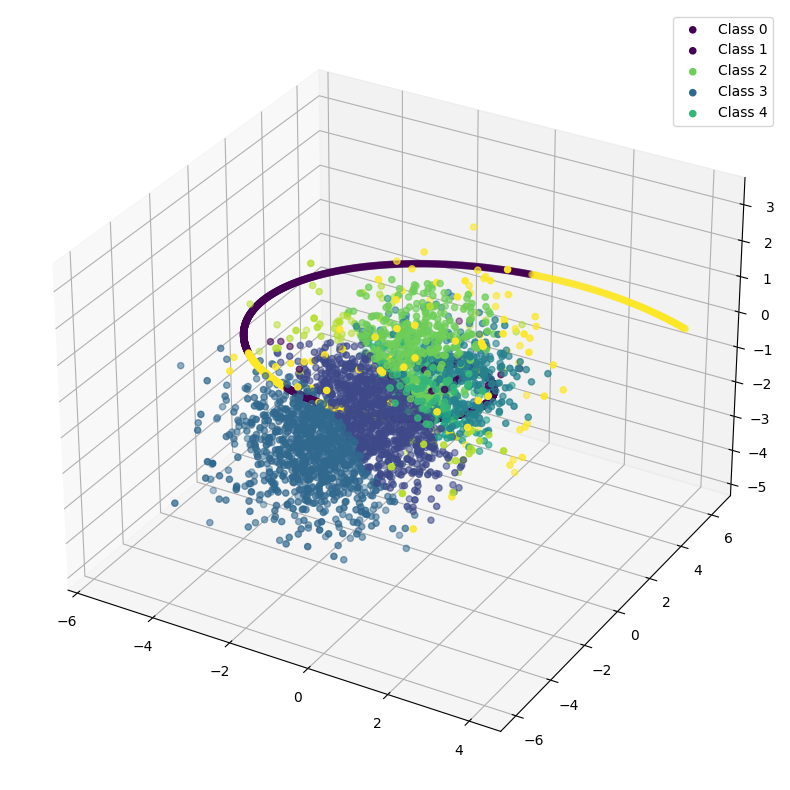

In [ ]:
experiment(2, 8)

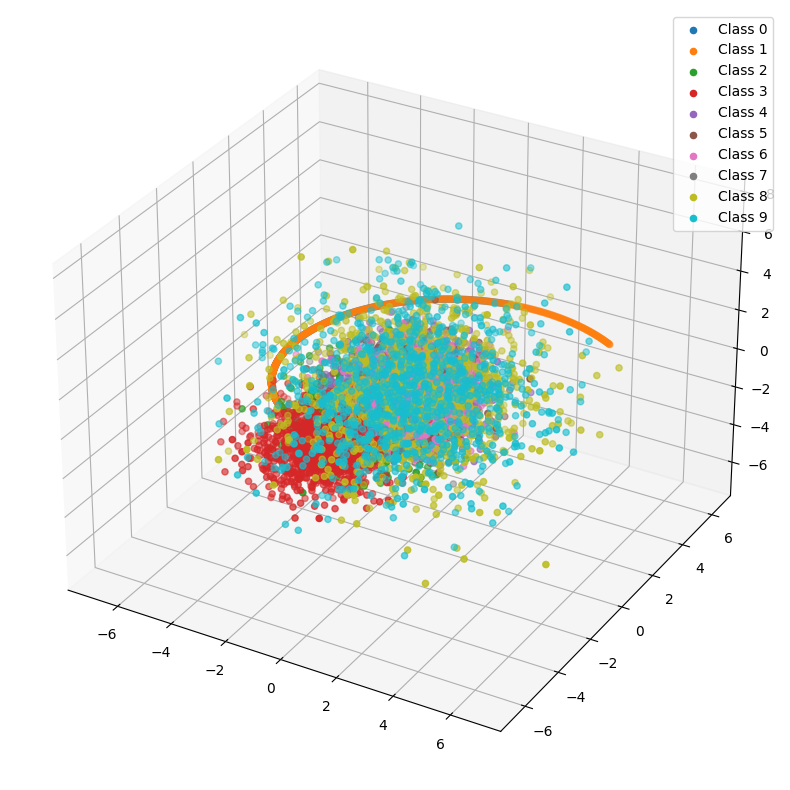

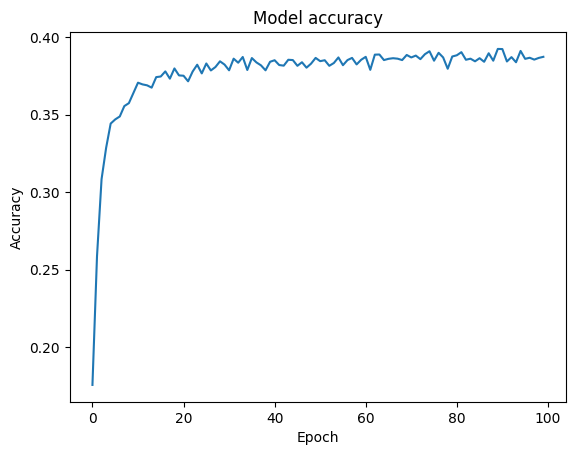

313/313 [==============================] - 0s 1ms/step


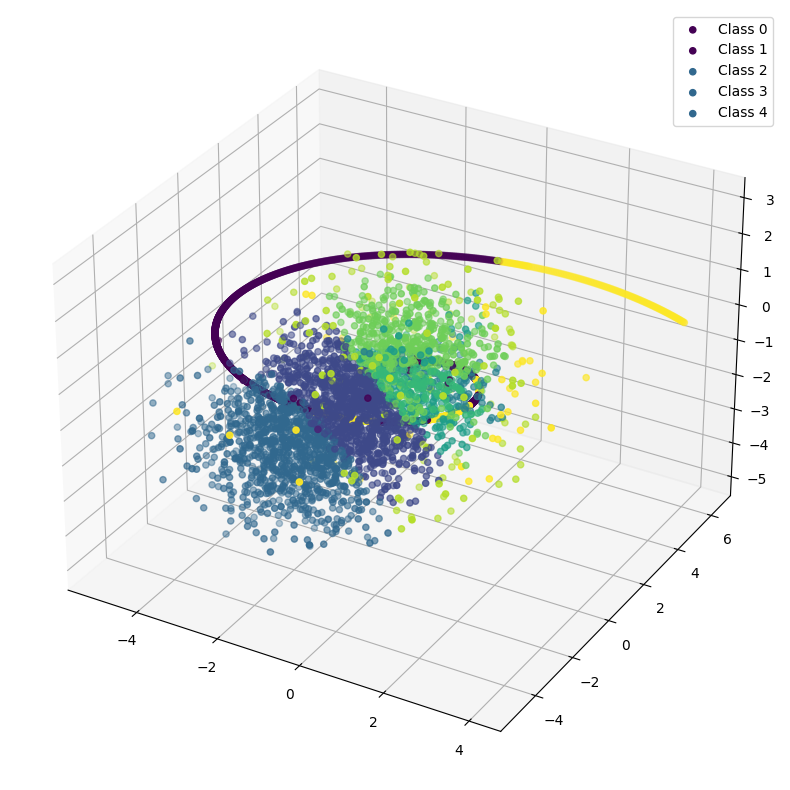

In [ ]:
experiment(2, 16)

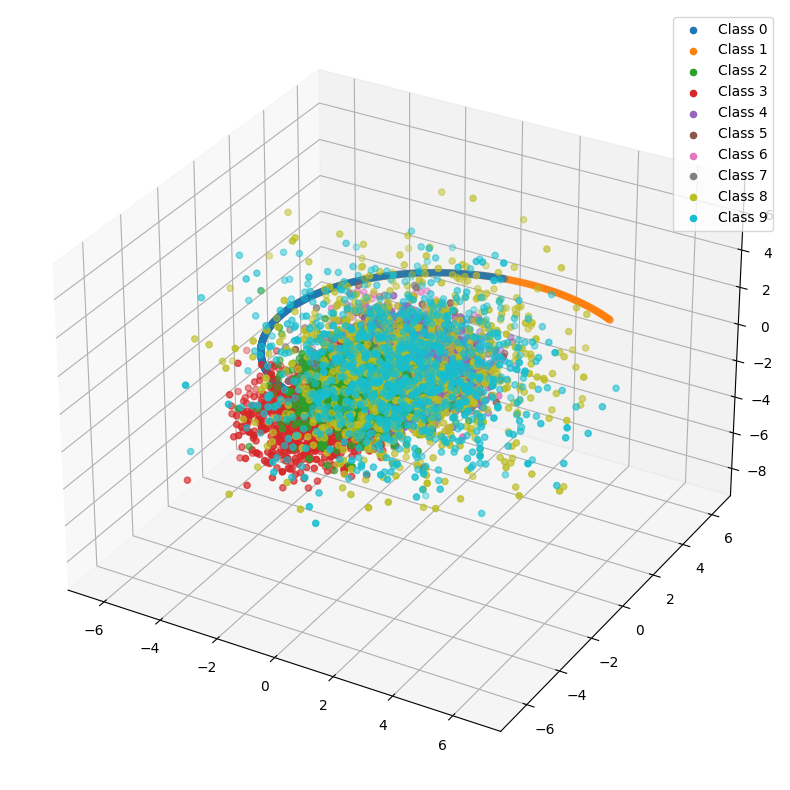

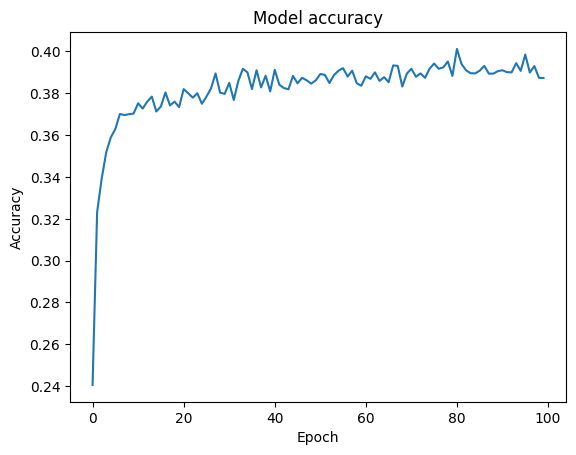

313/313 [==============================] - 0s 1ms/step


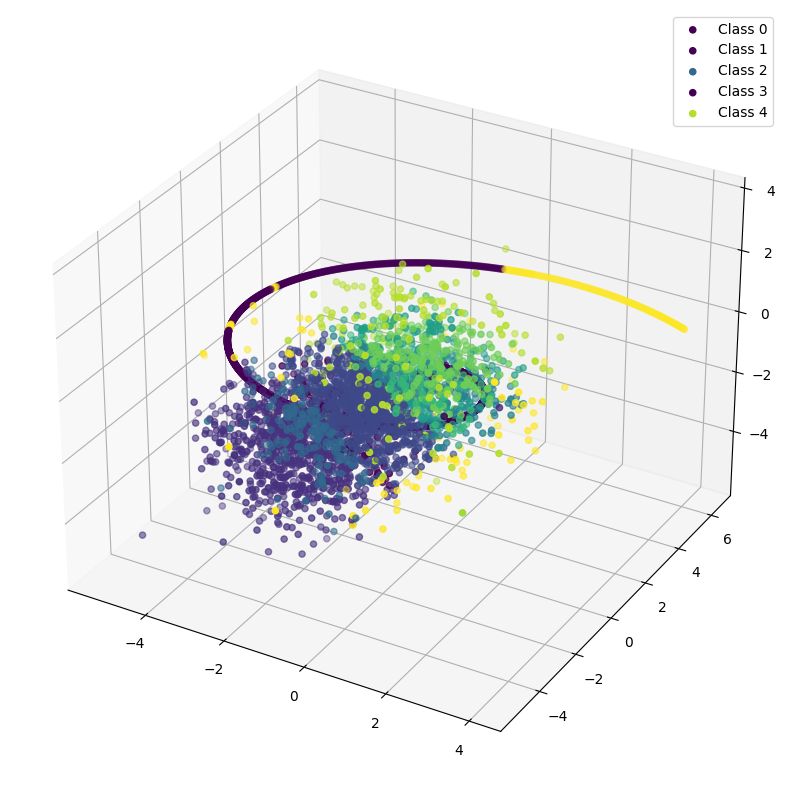

In [ ]:
experiment(2, 32)

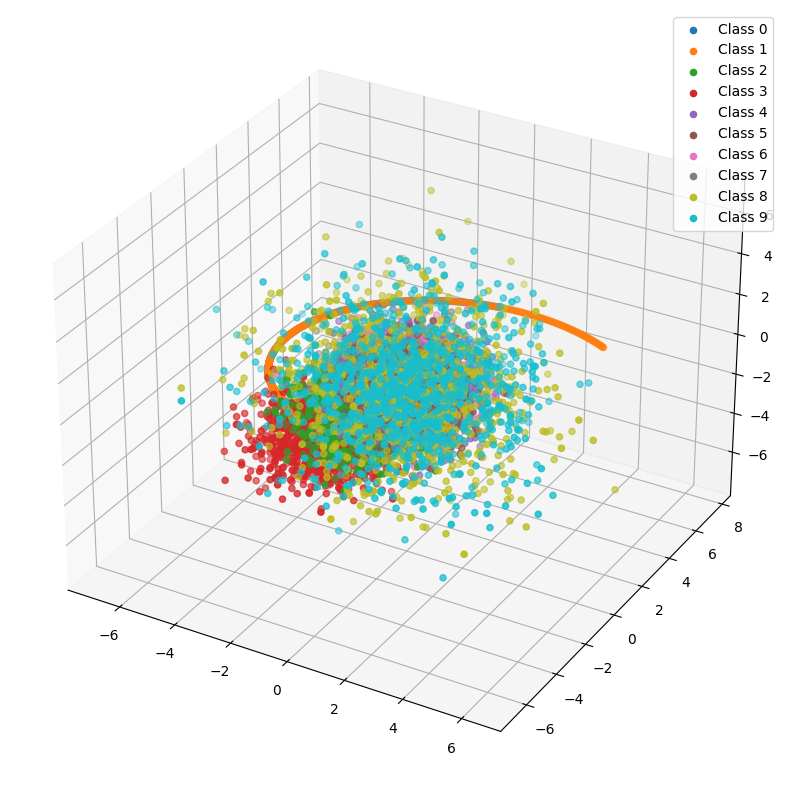

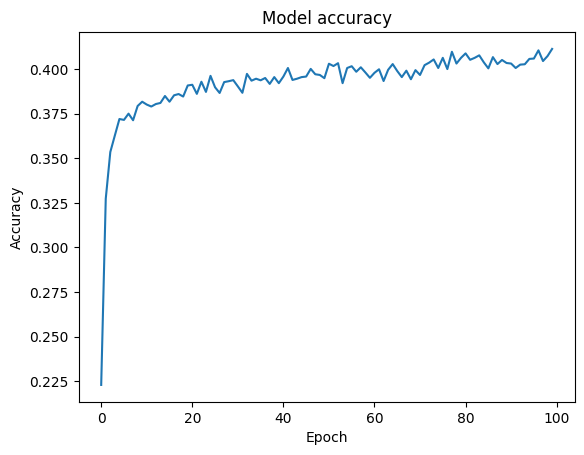

313/313 [==============================] - 0s 1ms/step


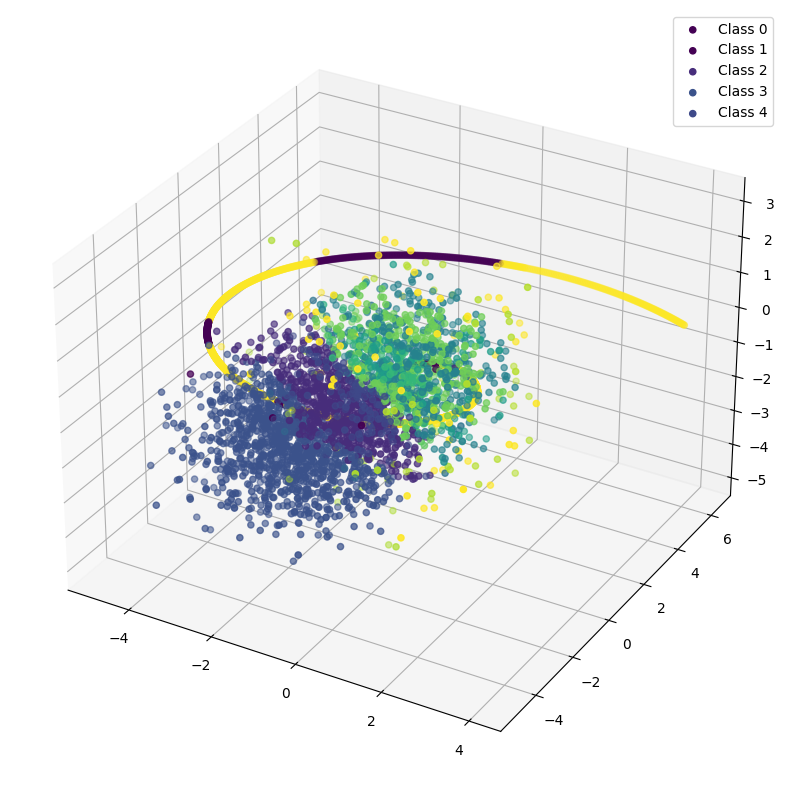

In [ ]:
experiment(2, 62)

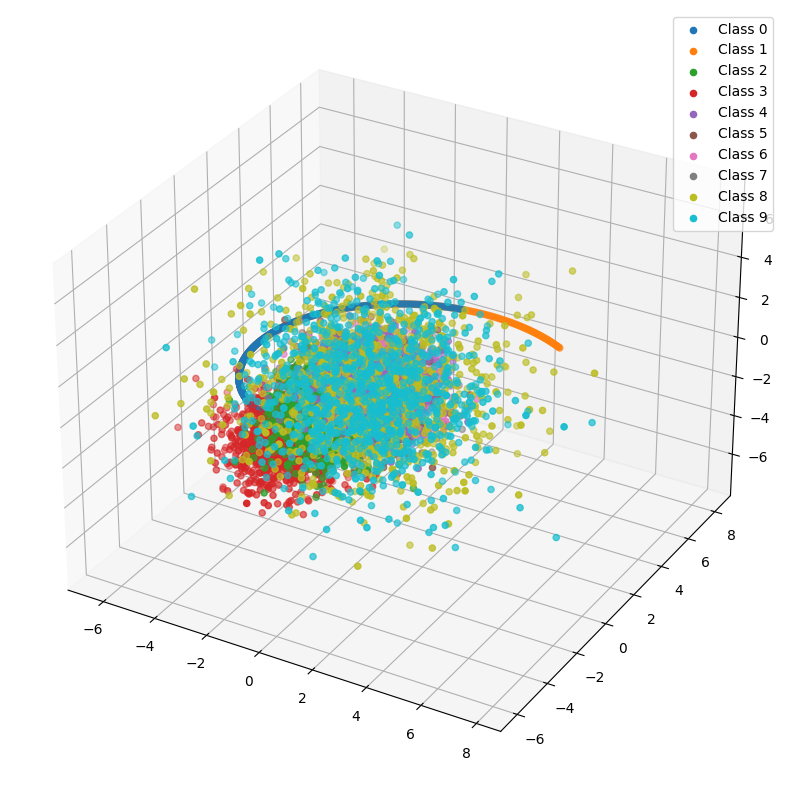

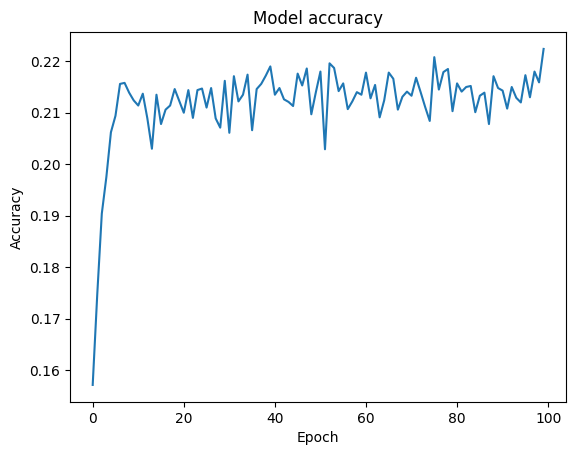

313/313 [==============================] - 0s 1ms/step


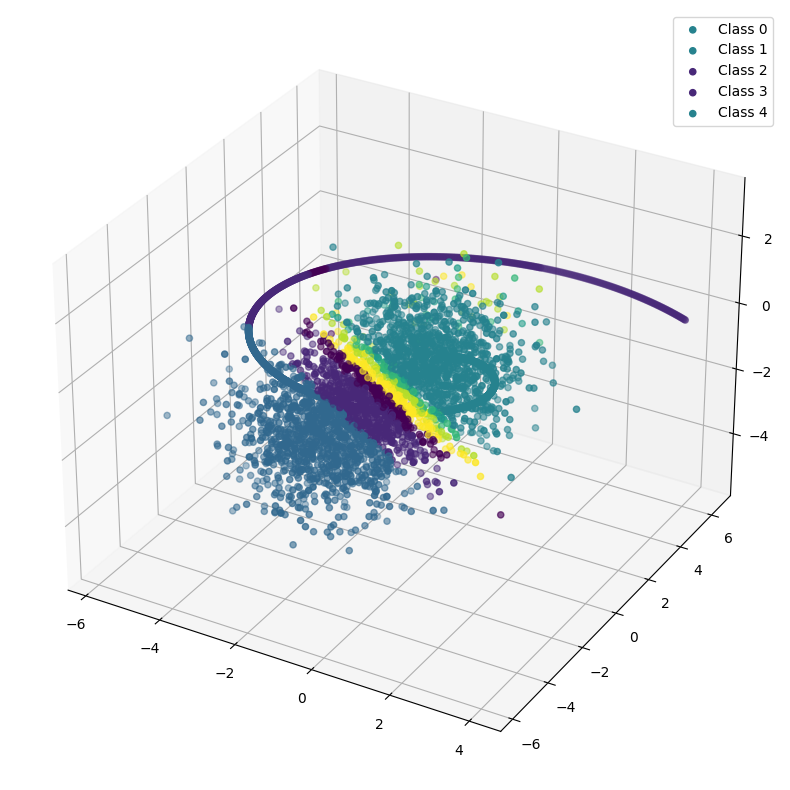

In [ ]:
experiment(3, 2)

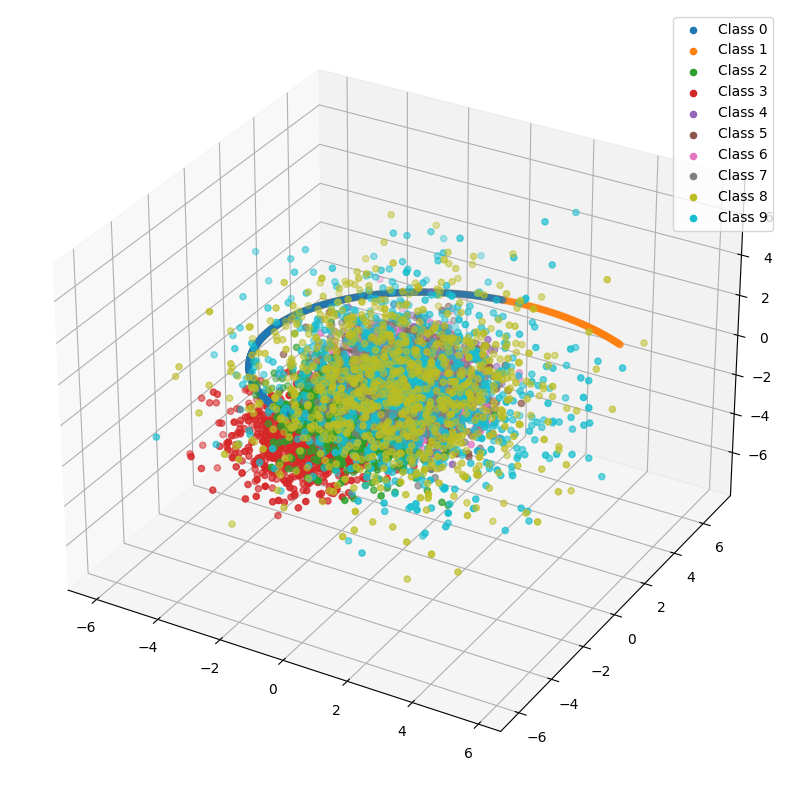

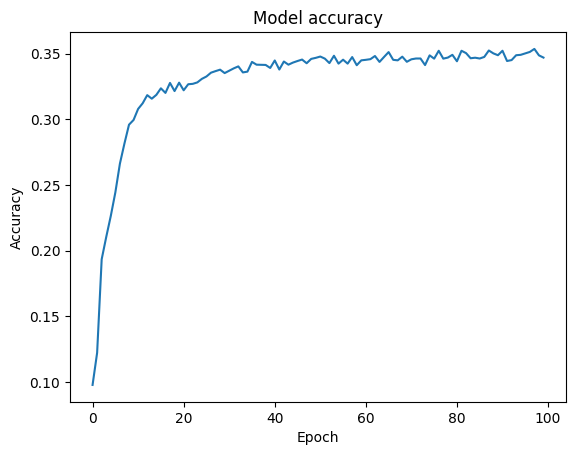

313/313 [==============================] - 1s 2ms/step


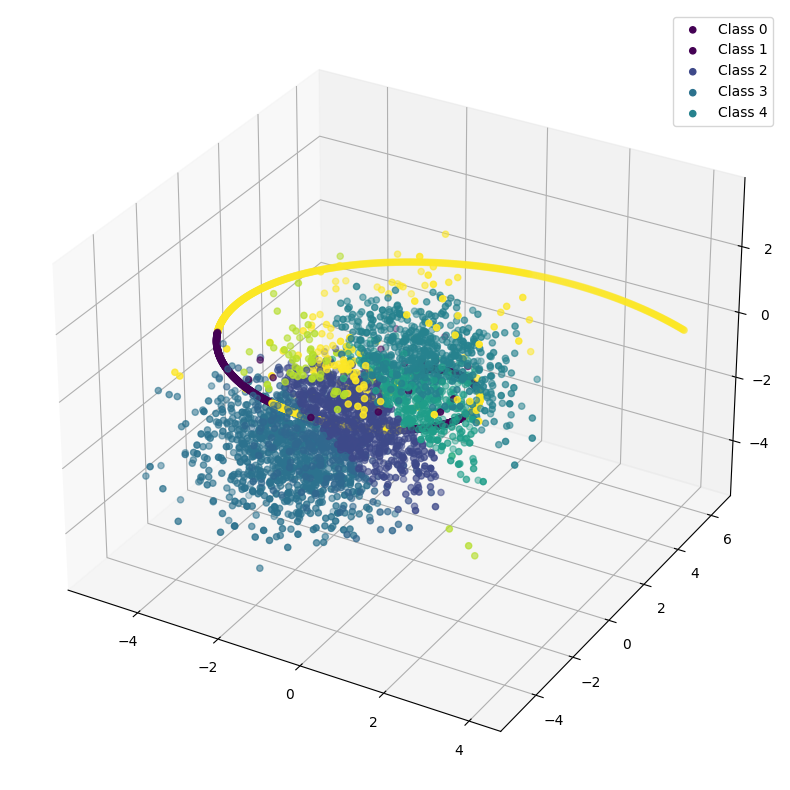

In [ ]:
experiment(3, 4)

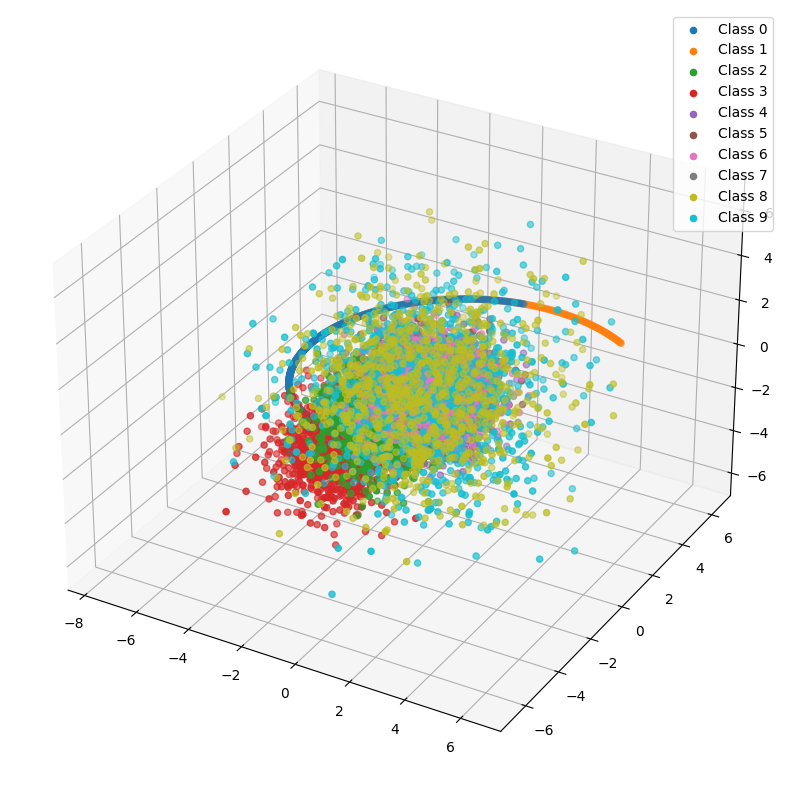

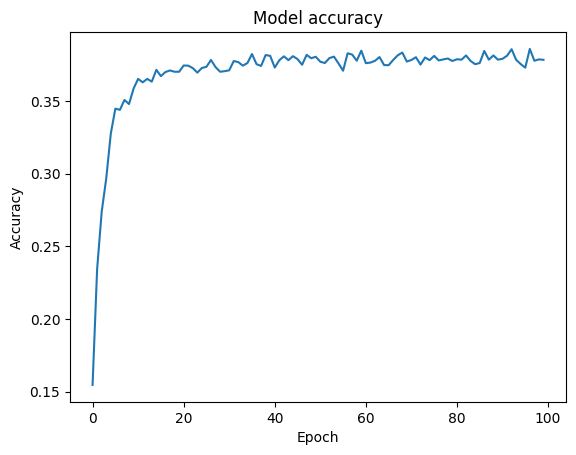

313/313 [==============================] - 0s 1ms/step


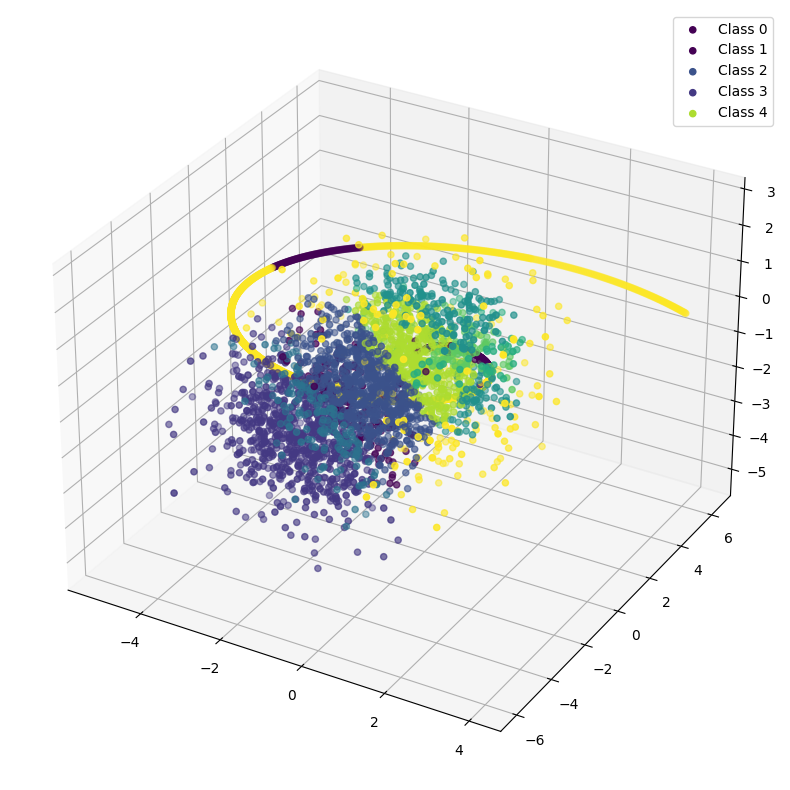

In [ ]:
experiment(3, 8)

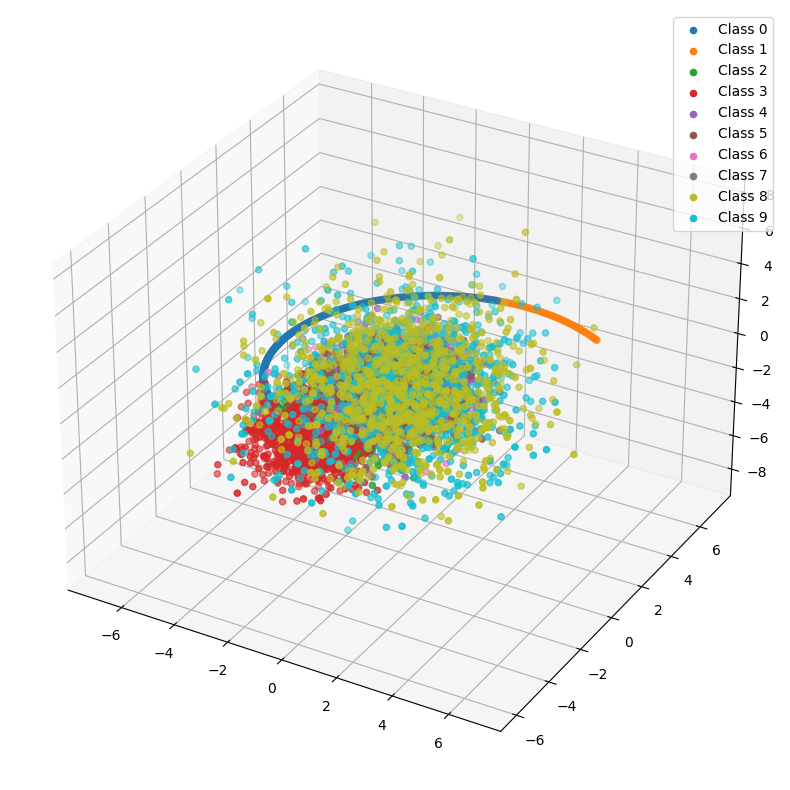

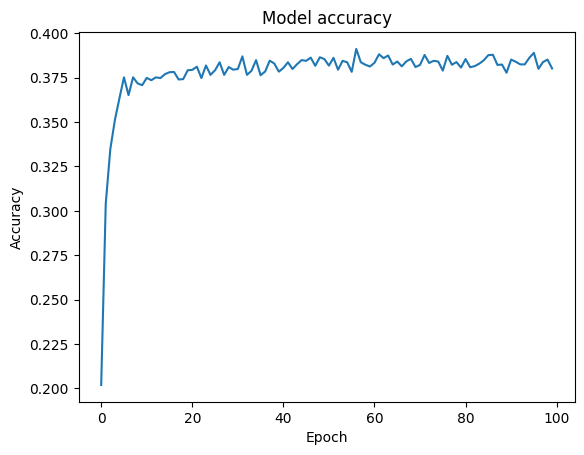

313/313 [==============================] - 0s 1ms/step


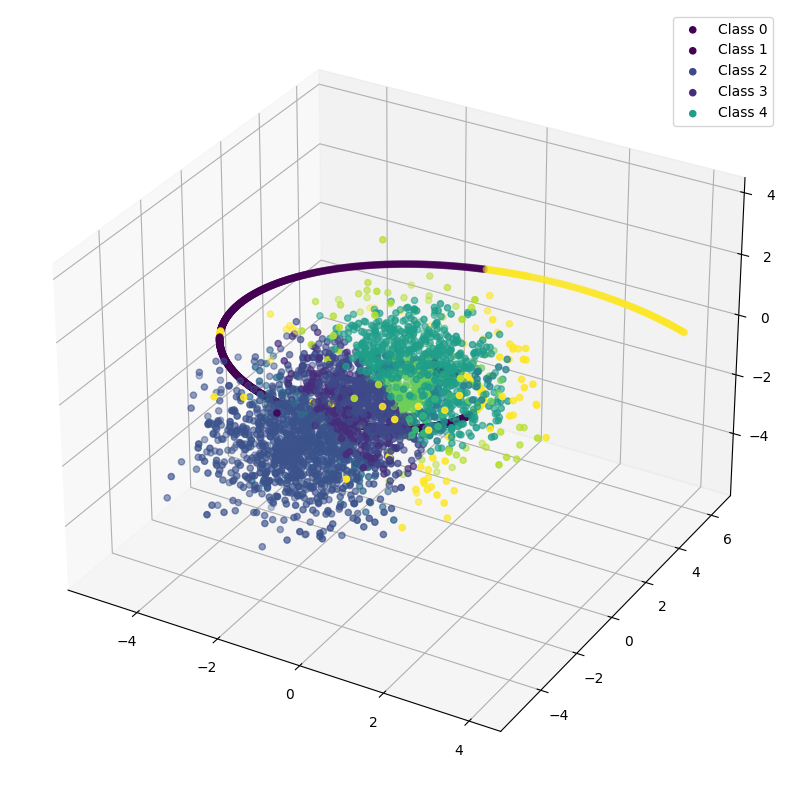

In [ ]:
experiment(3, 16)

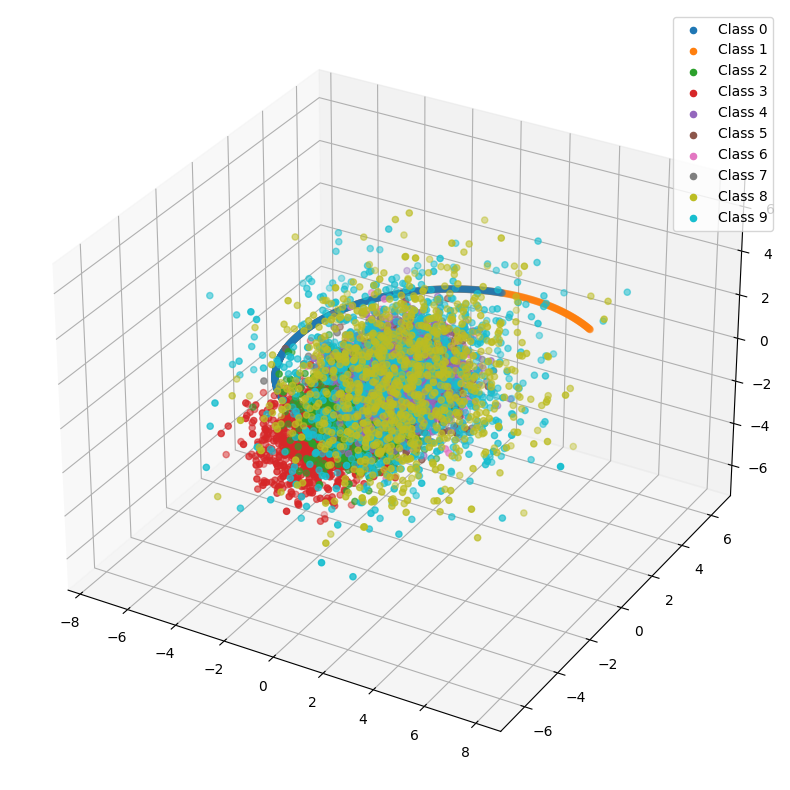

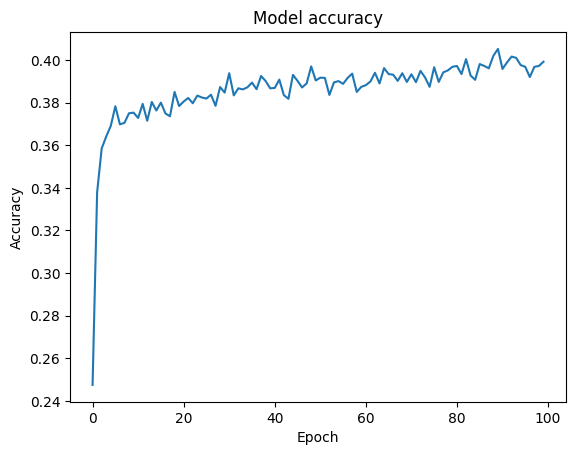

313/313 [==============================] - 1s 2ms/step


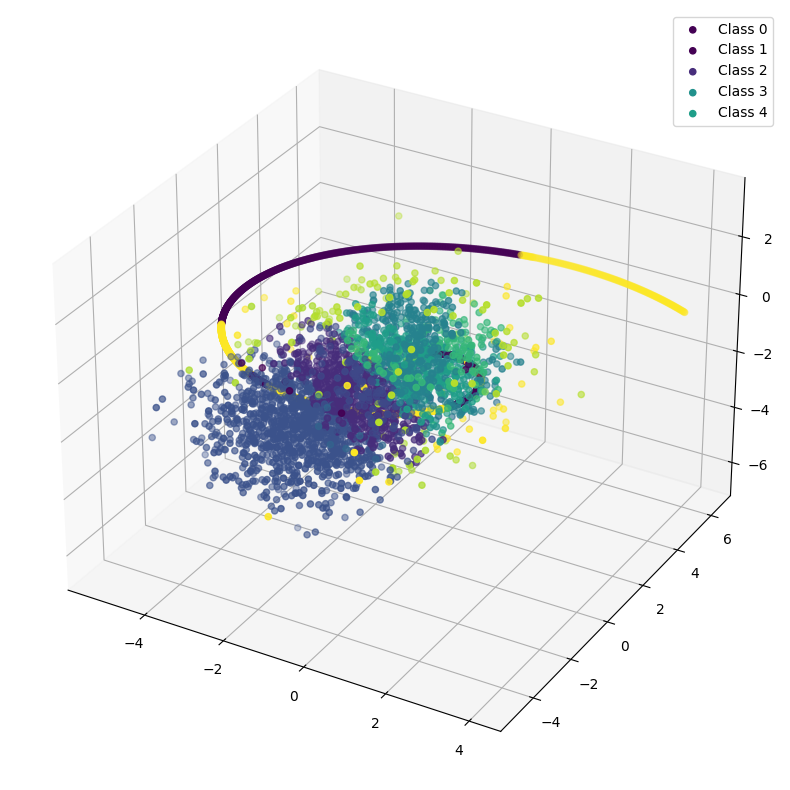

In [ ]:
experiment(3, 32)

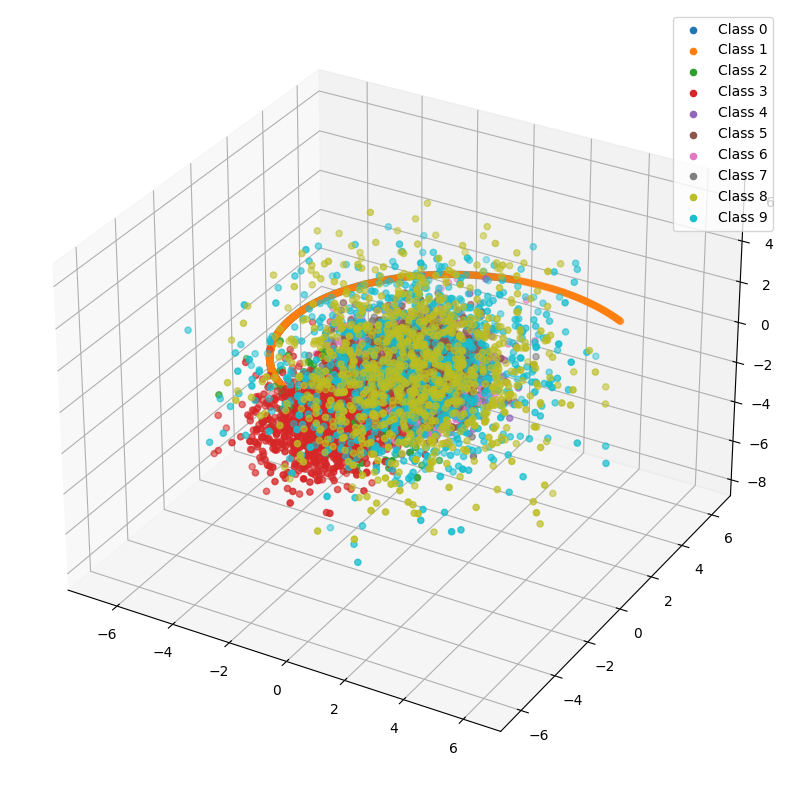

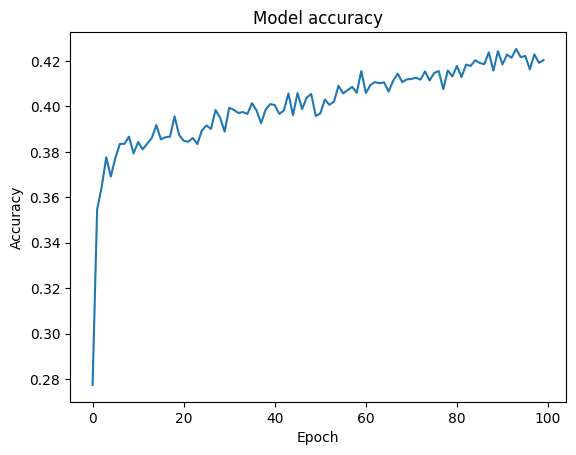

313/313 [==============================] - 0s 1ms/step


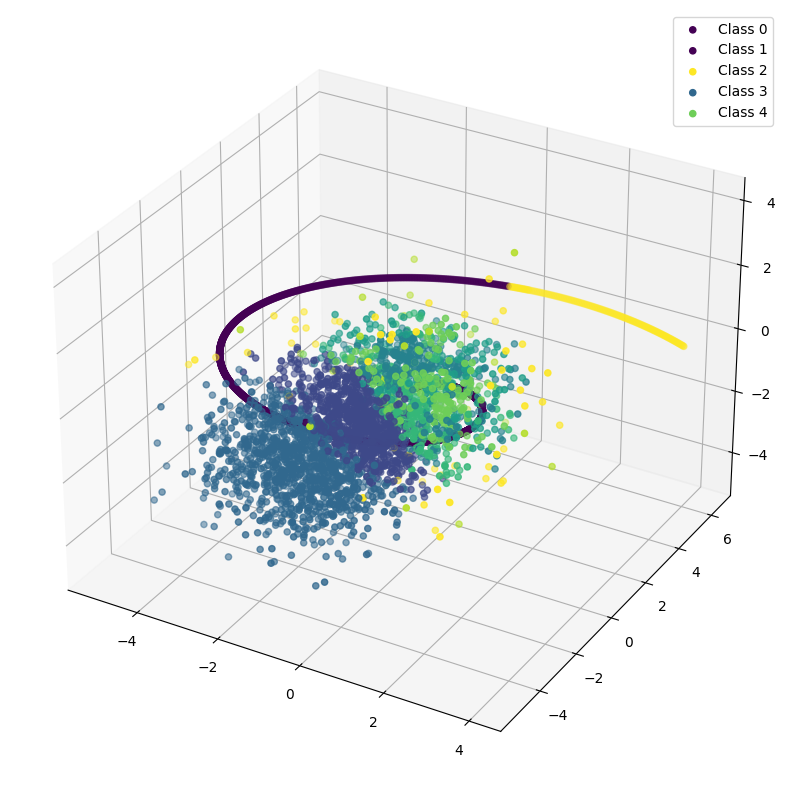

In [ ]:
experiment(3, 64)

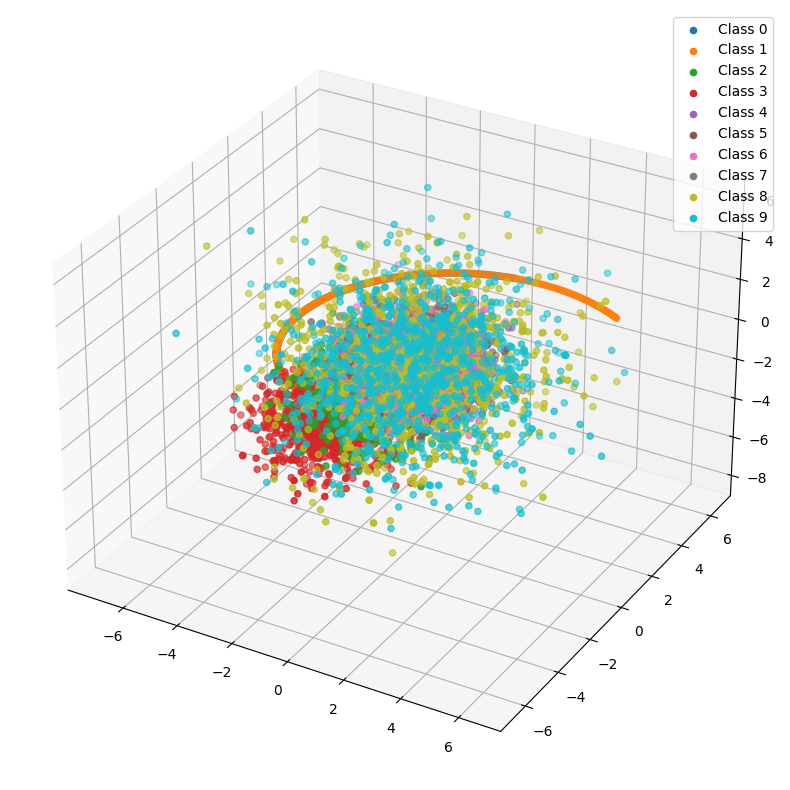

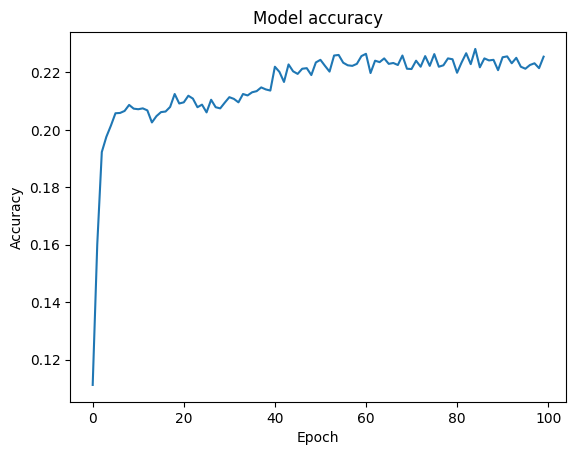

313/313 [==============================] - 0s 1ms/step


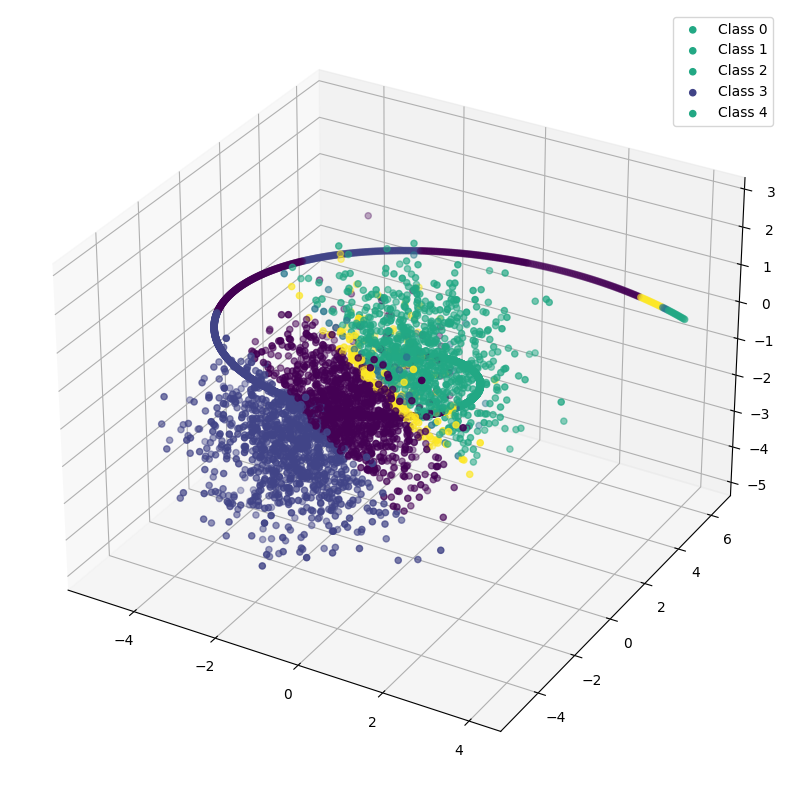

In [ ]:
experiment(4, 2)

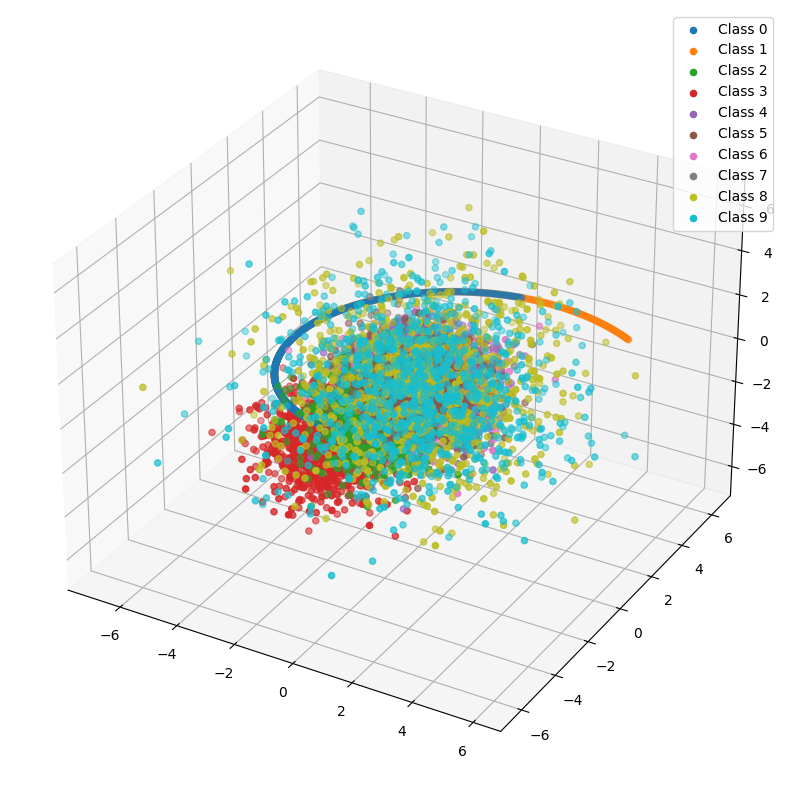

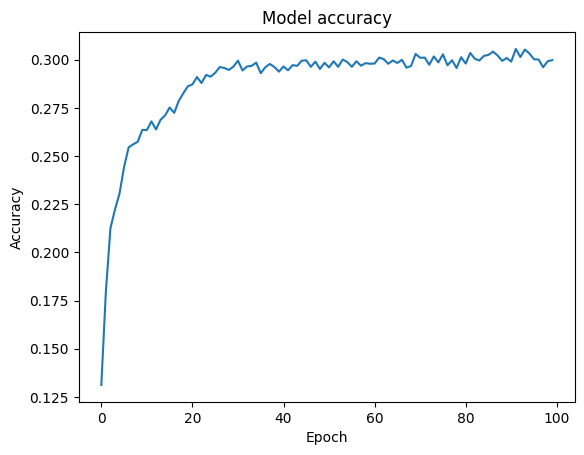

313/313 [==============================] - 0s 1ms/step


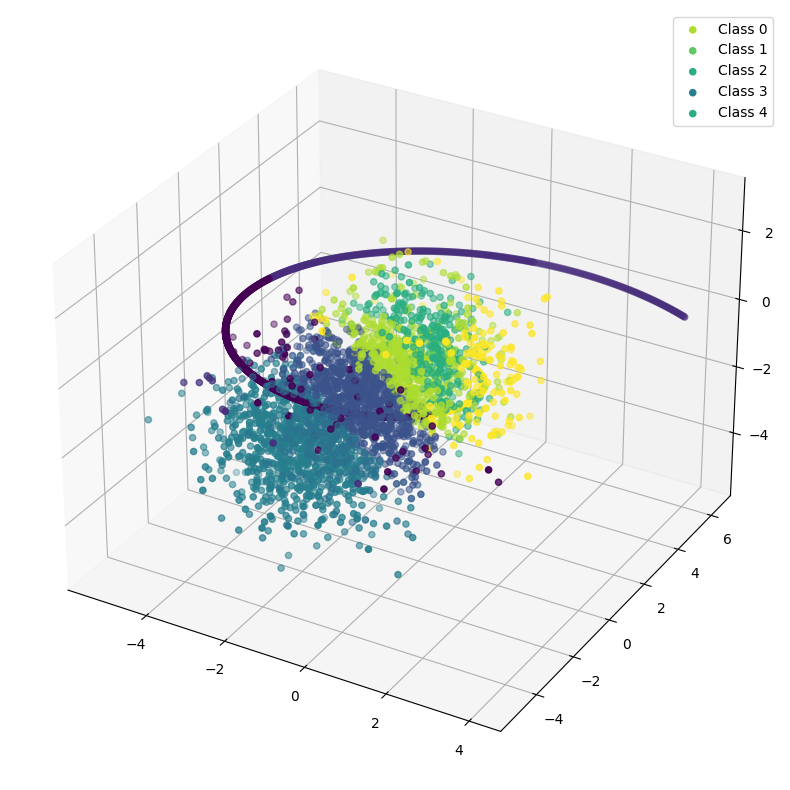

In [ ]:
experiment(4, 4)

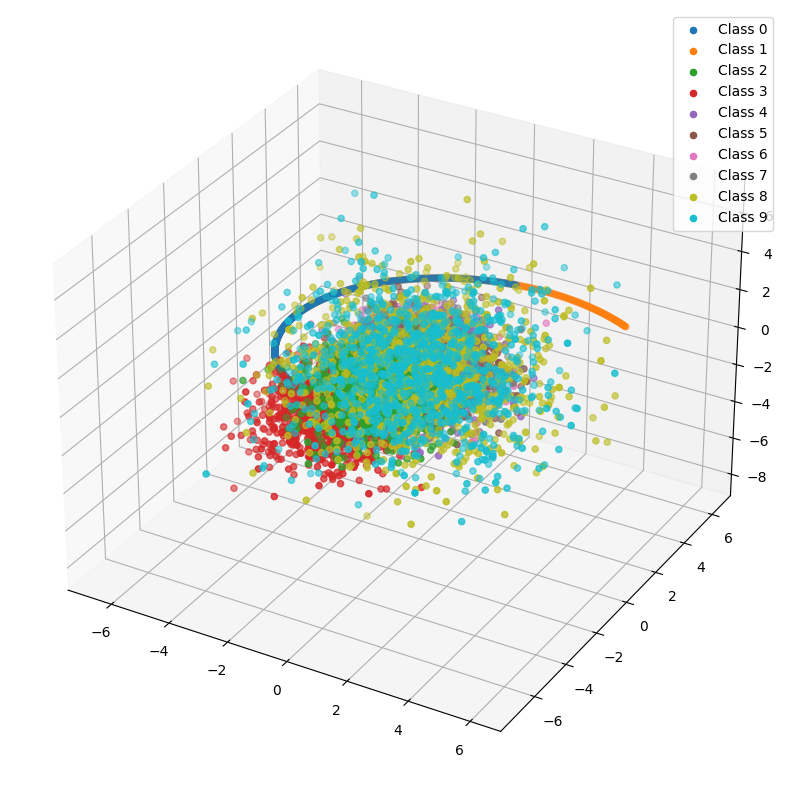

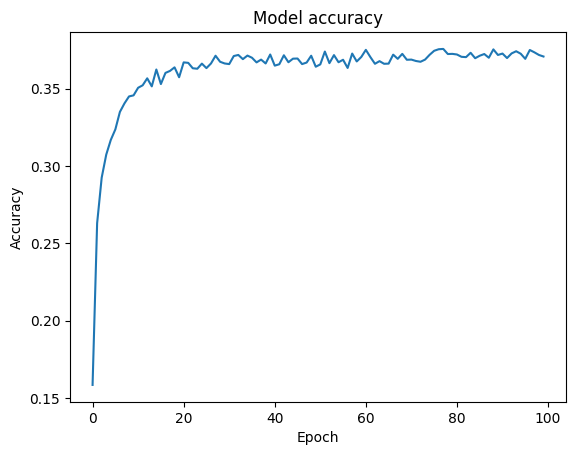

313/313 [==============================] - 0s 1ms/step


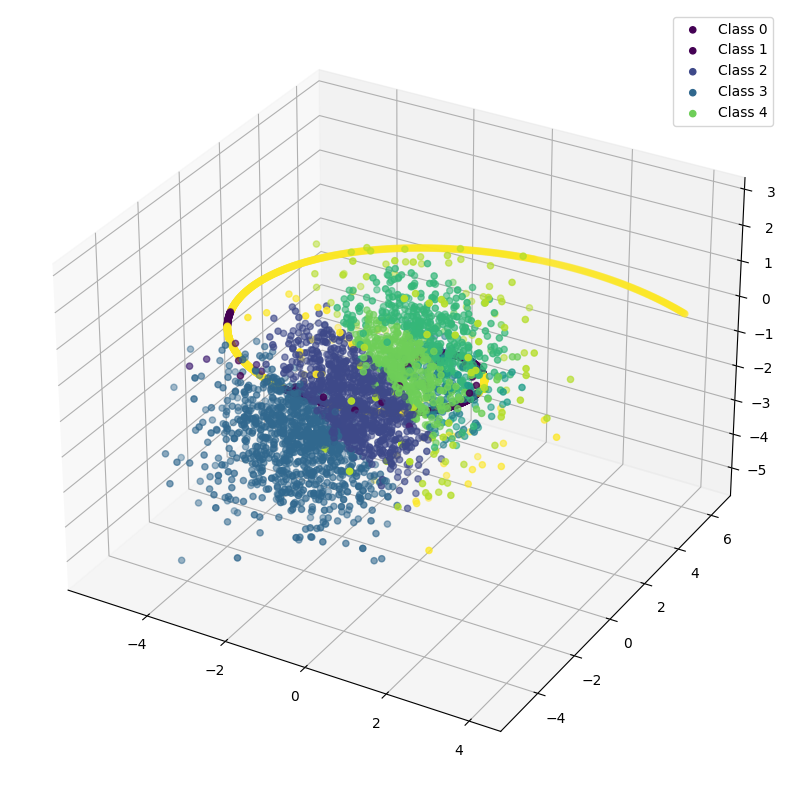

In [ ]:
experiment(4, 8)

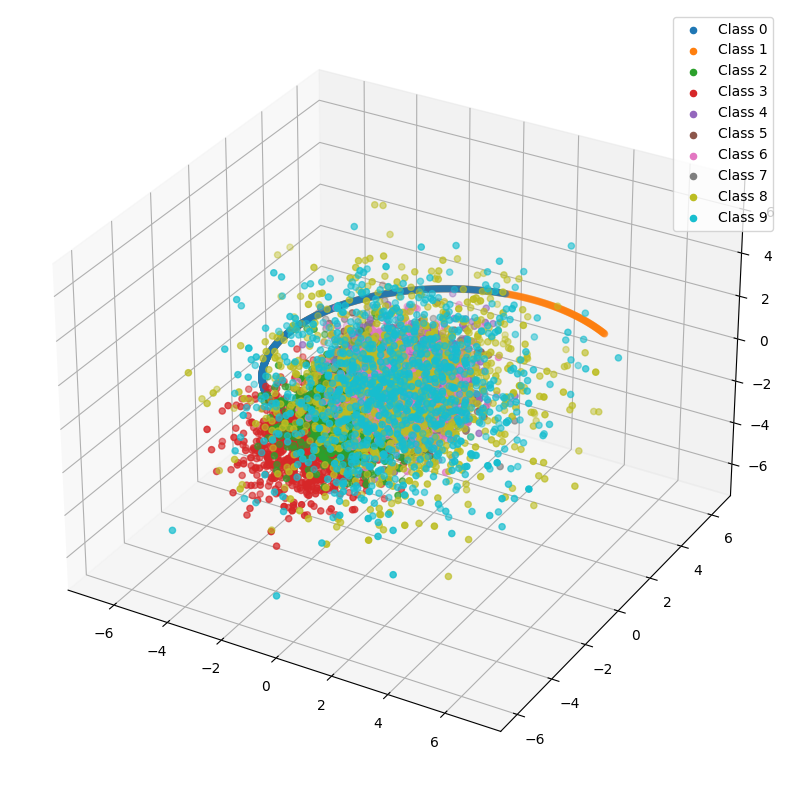

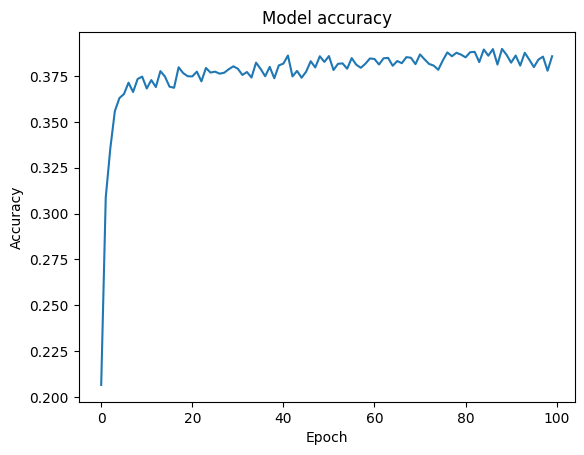

313/313 [==============================] - 1s 1ms/step


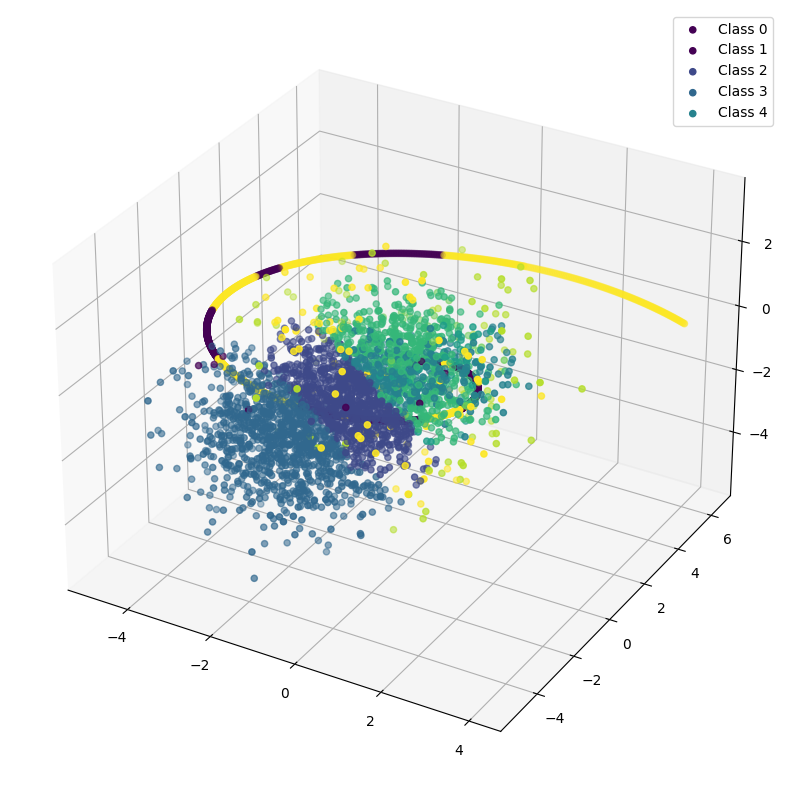

In [ ]:
experiment(4, 16)

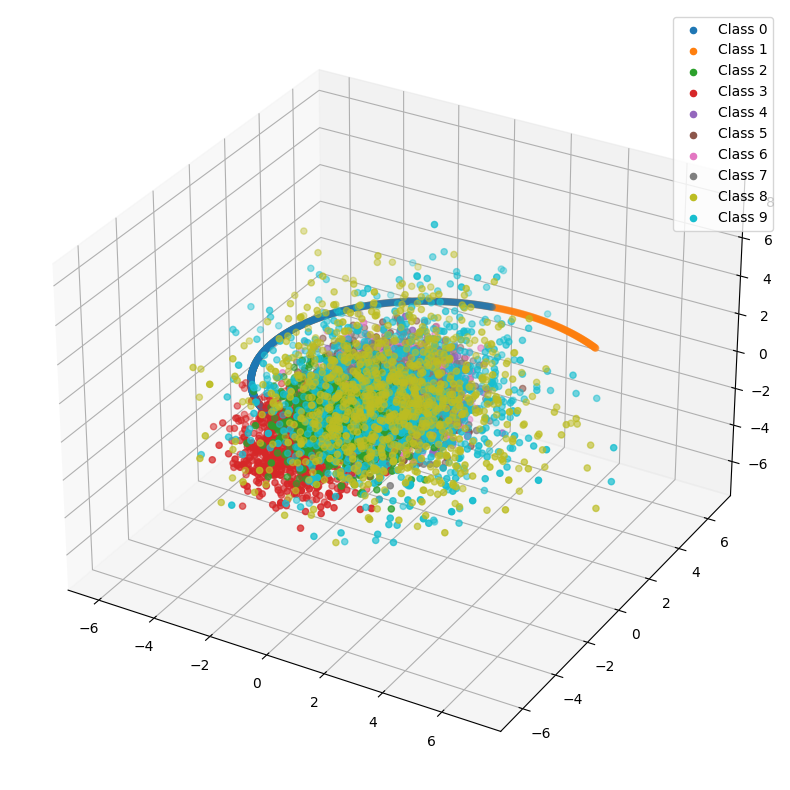

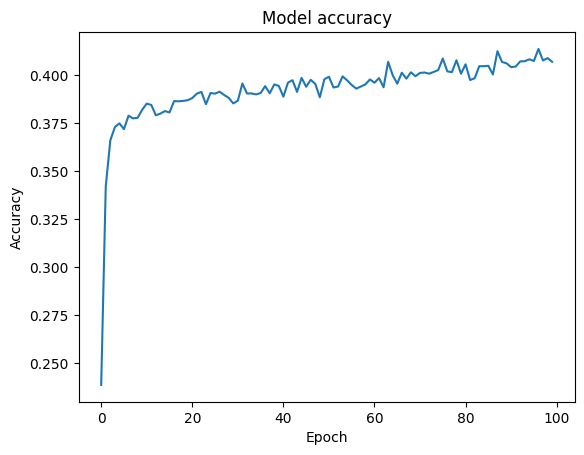

313/313 [==============================] - 0s 1ms/step


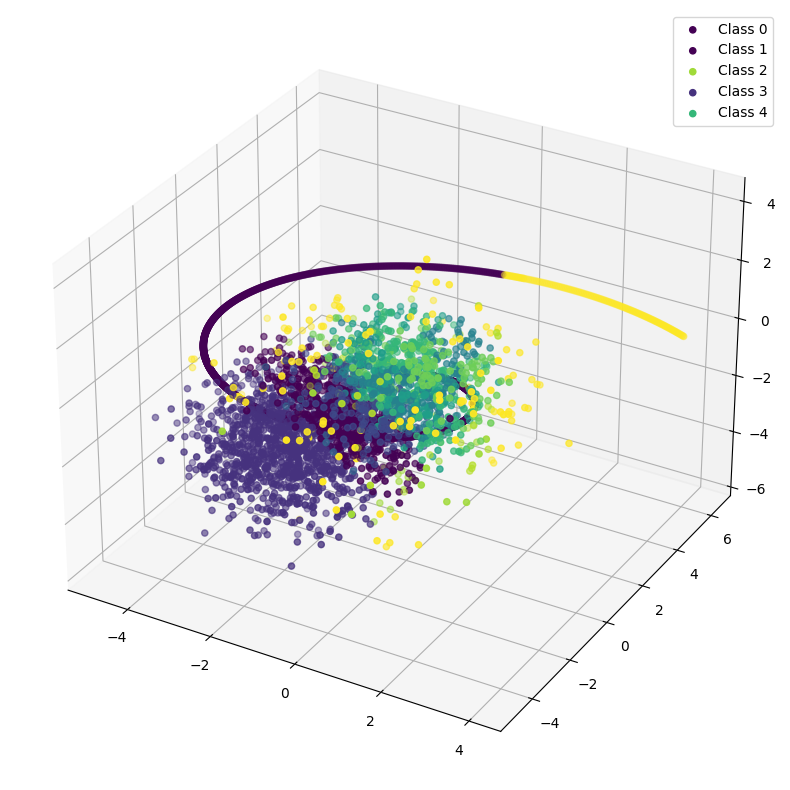

In [ ]:
experiment(4, 32)

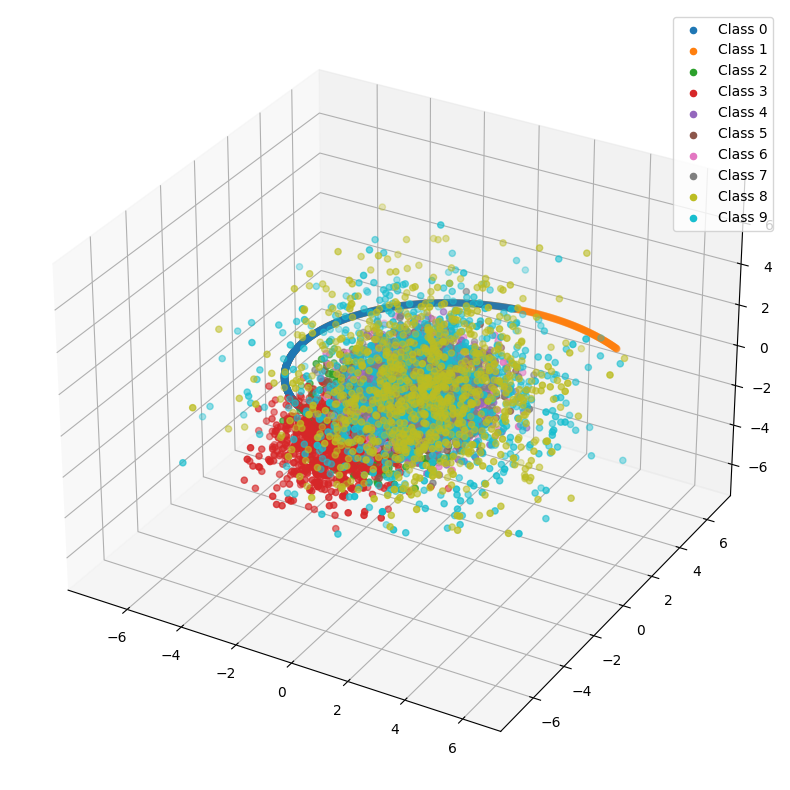

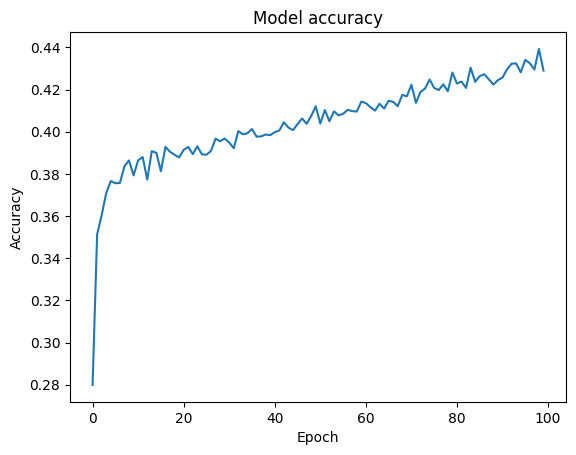

313/313 [==============================] - 0s 1ms/step


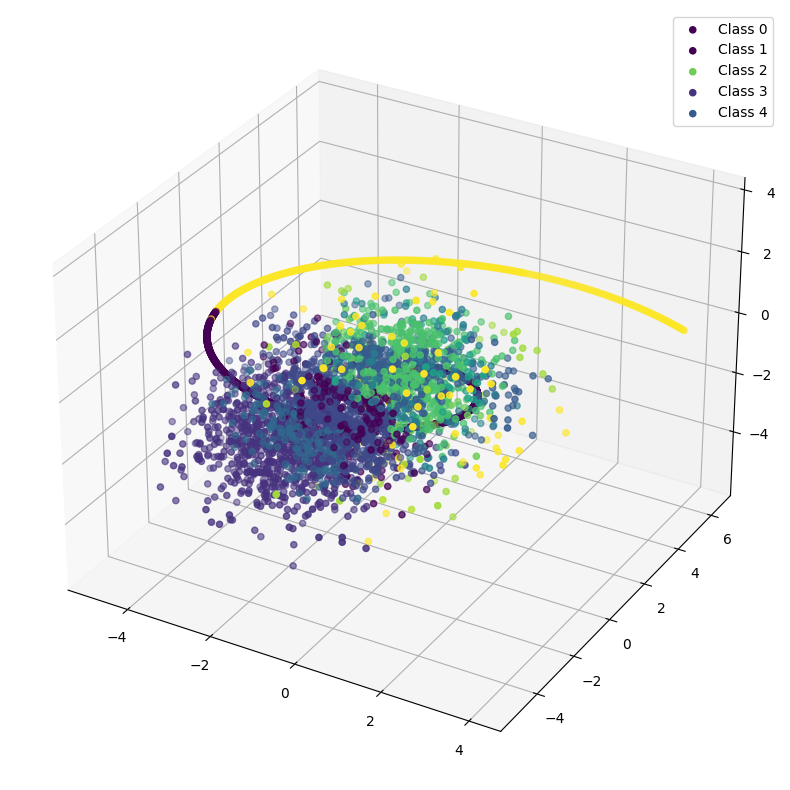

In [ ]:
experiment(4, 64)

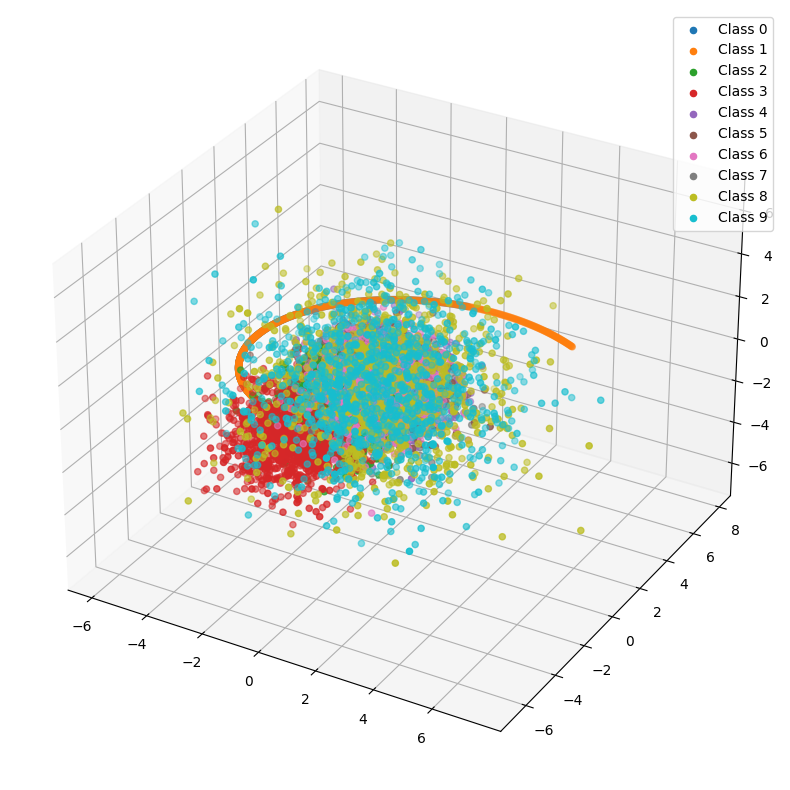

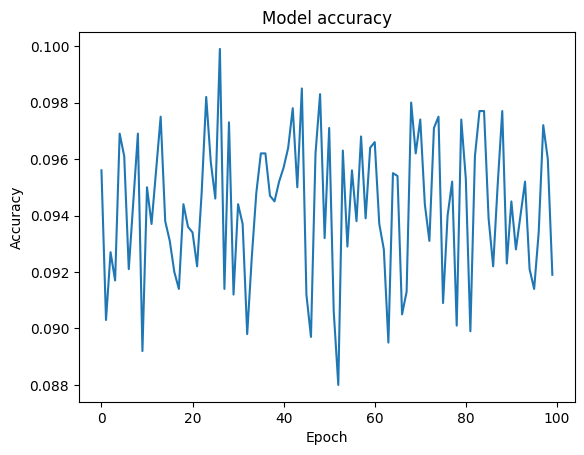

313/313 [==============================] - 0s 1ms/step


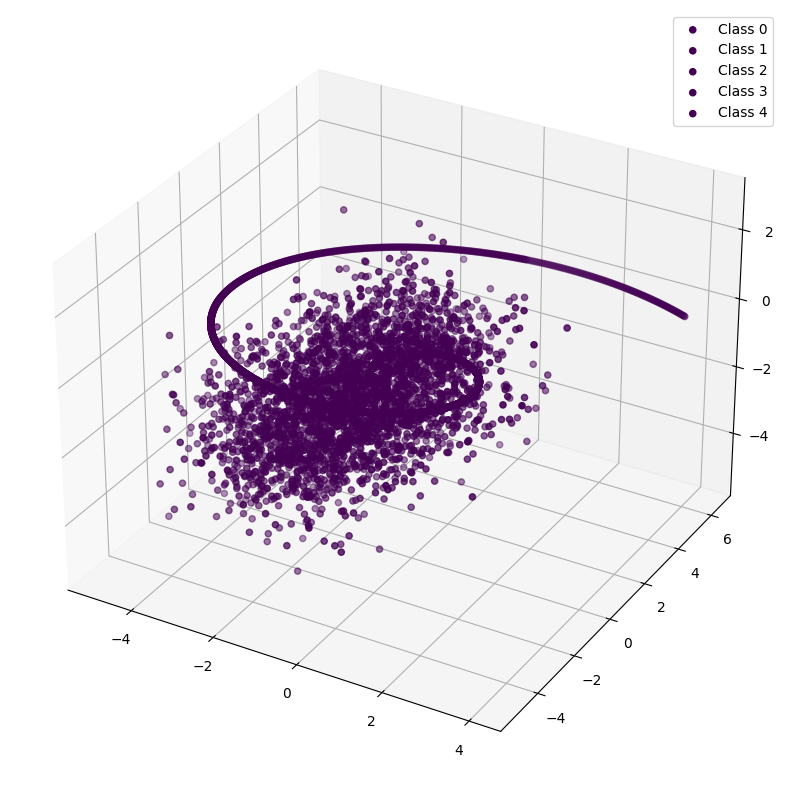

In [ ]:
experiment(5, 2)

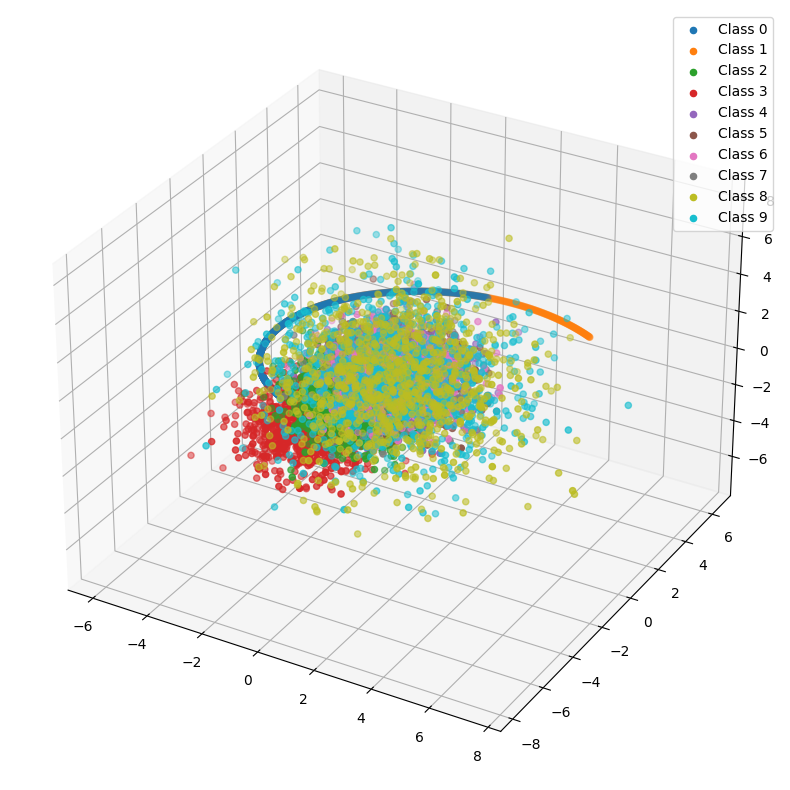

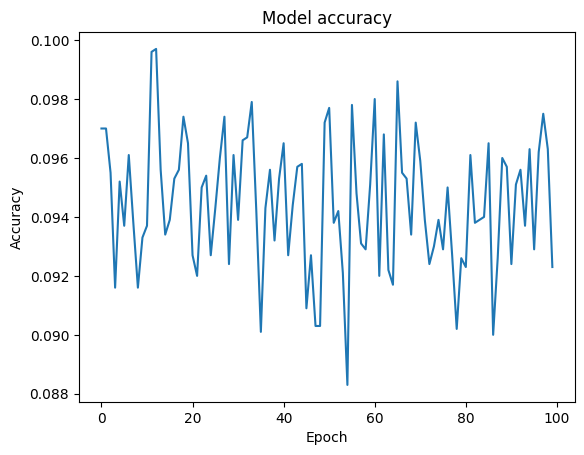

313/313 [==============================] - 1s 2ms/step


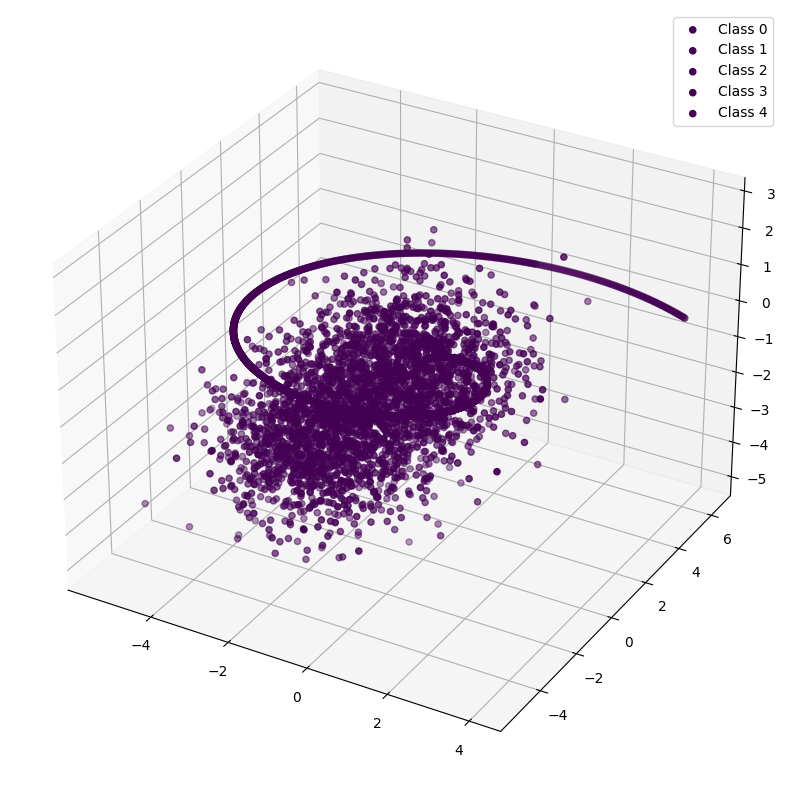

In [ ]:
experiment(5, 4)

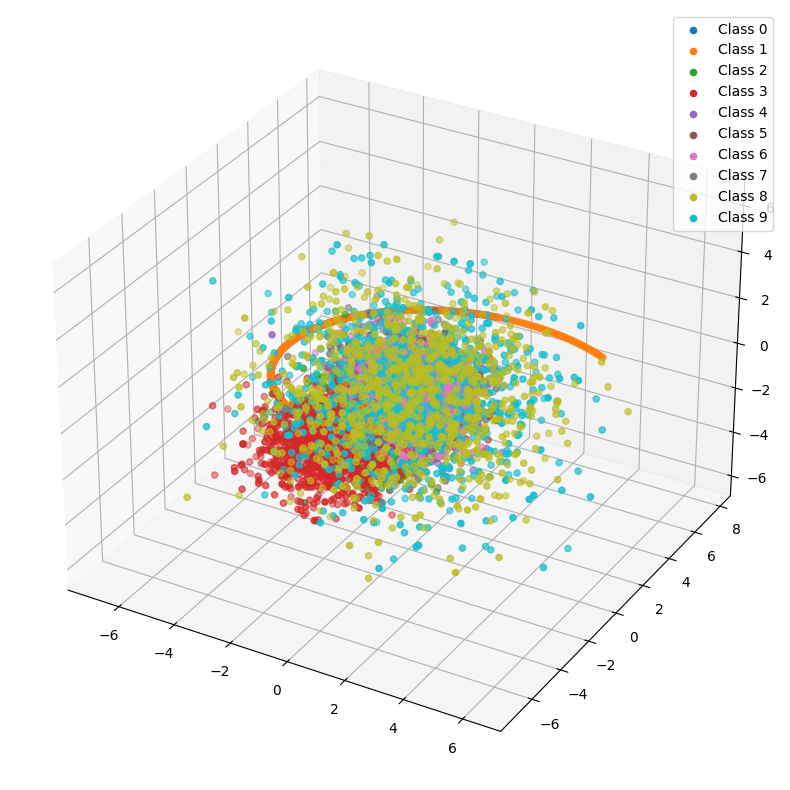

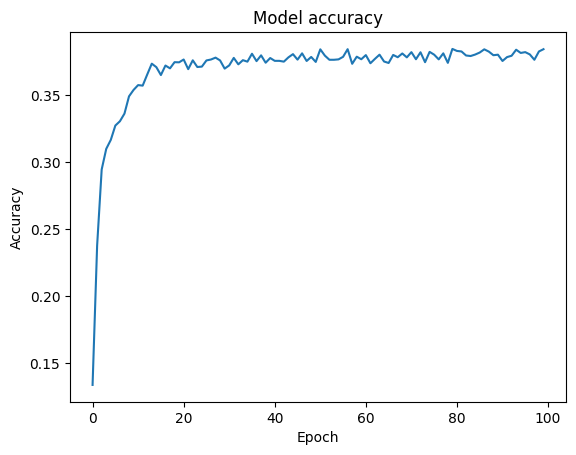

313/313 [==============================] - 1s 2ms/step


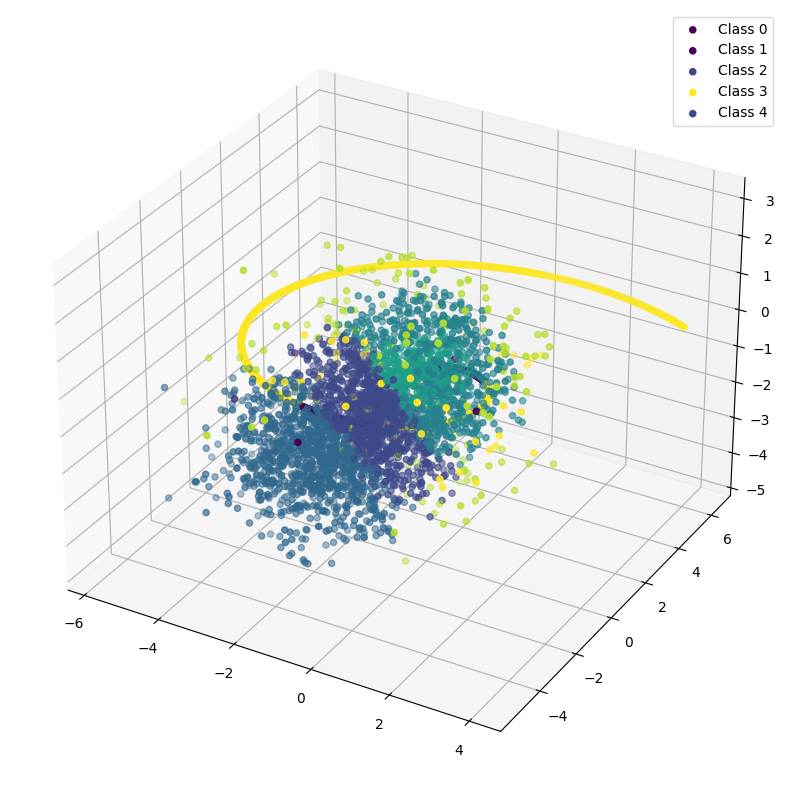

In [ ]:
experiment(5, 8)

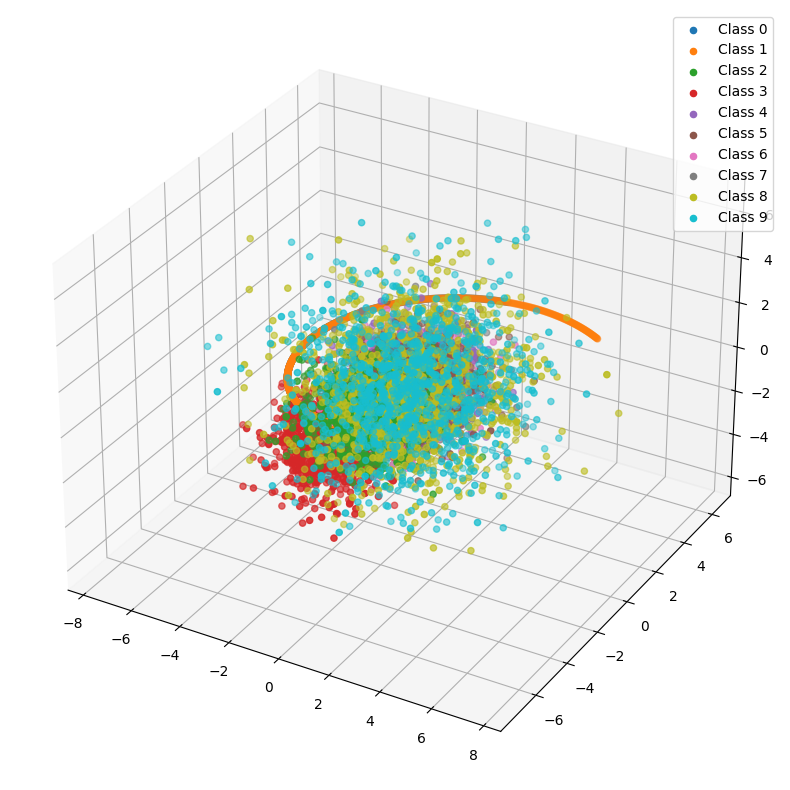

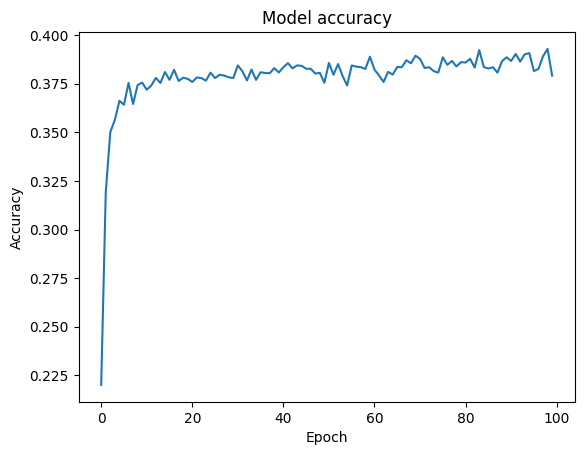

313/313 [==============================] - 1s 2ms/step


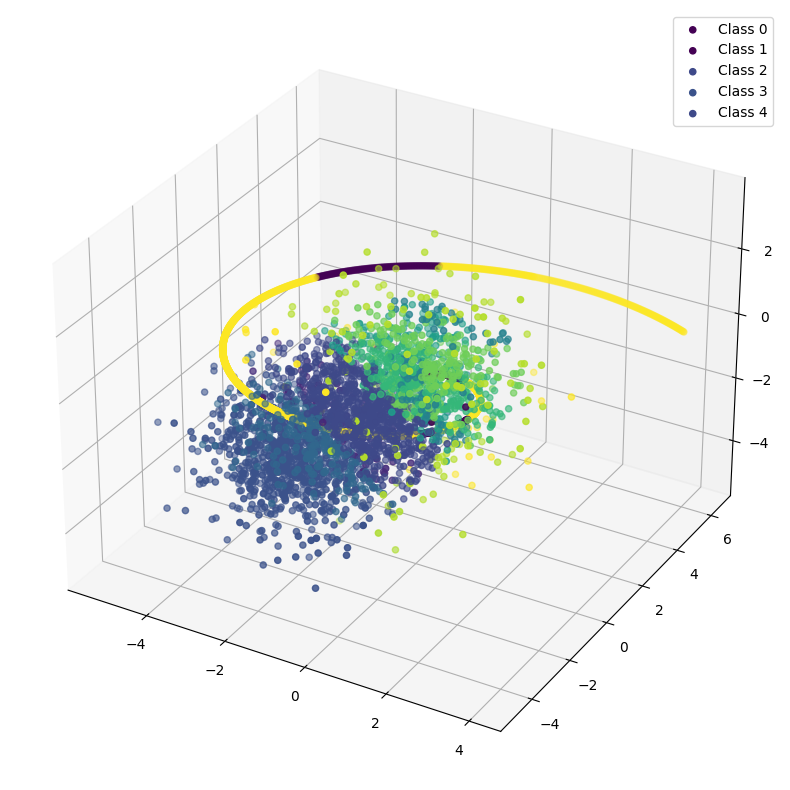

In [ ]:
experiment(5, 16)

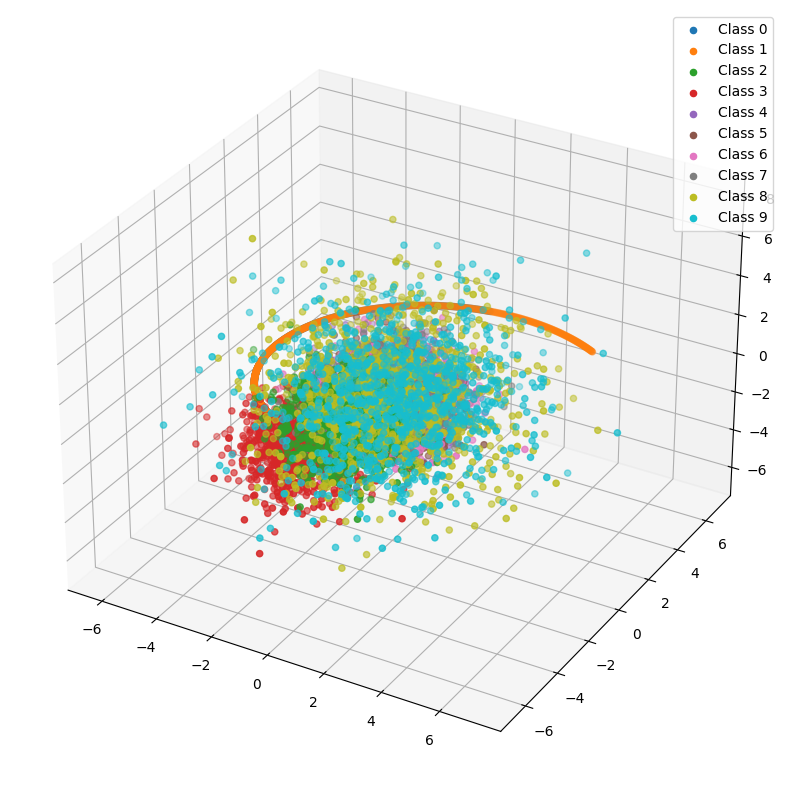

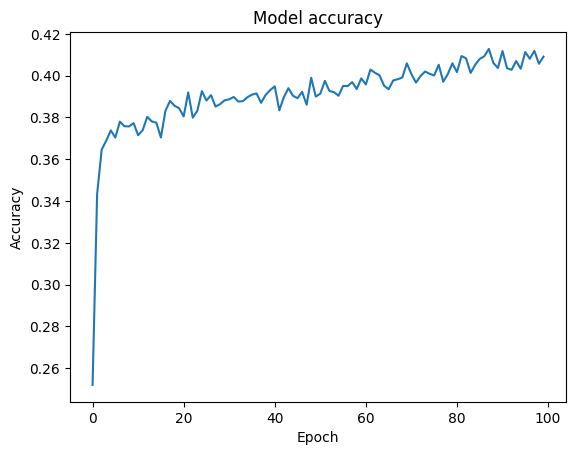

313/313 [==============================] - 1s 2ms/step


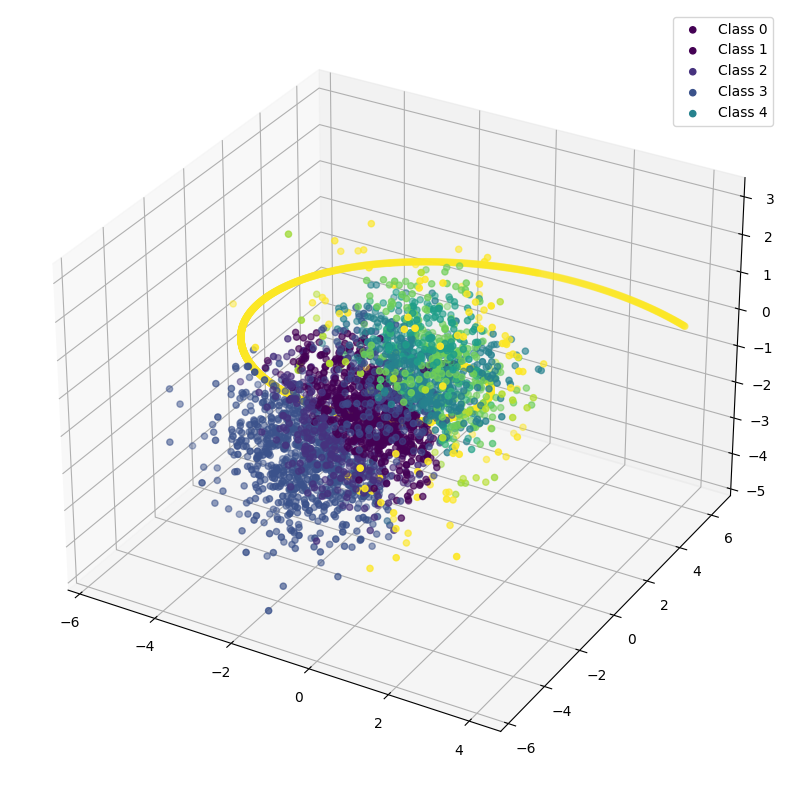

In [ ]:
experiment(5, 32)

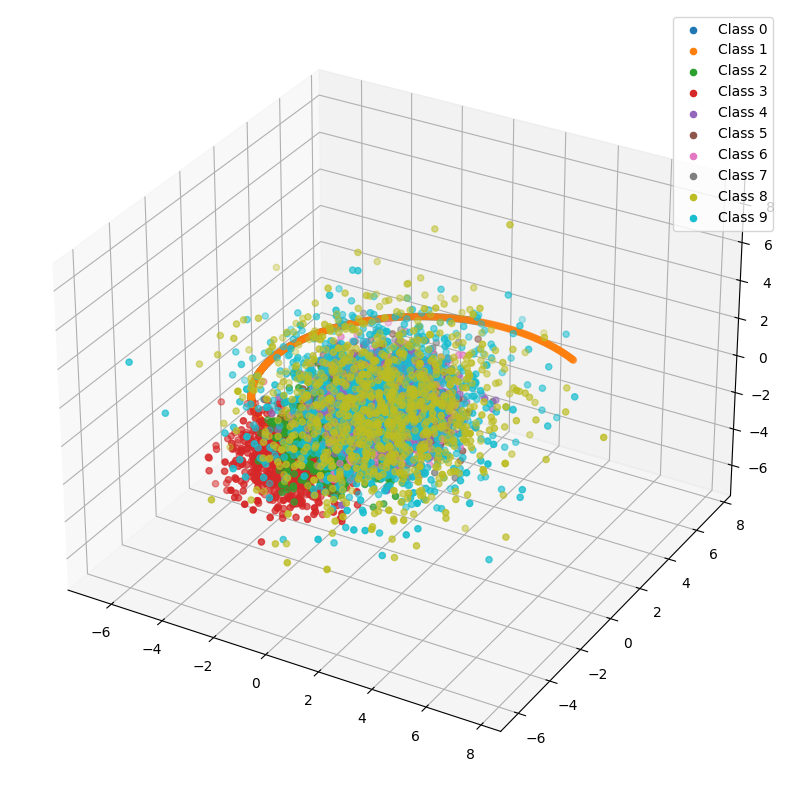

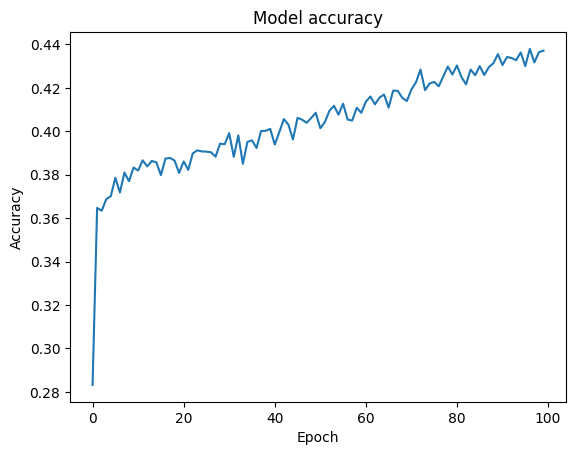

313/313 [==============================] - 1s 1ms/step


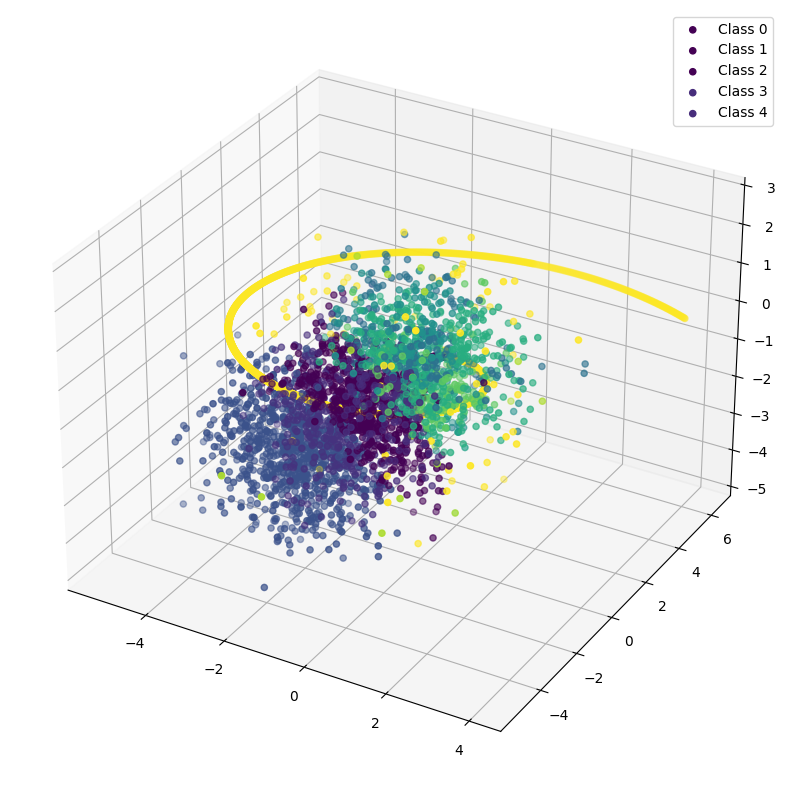

In [ ]:
experiment(5, 64)

In [ ]:
# Main function
def experiment(num_layers=2, neurons_per_layer=32, activation='sigmoid', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

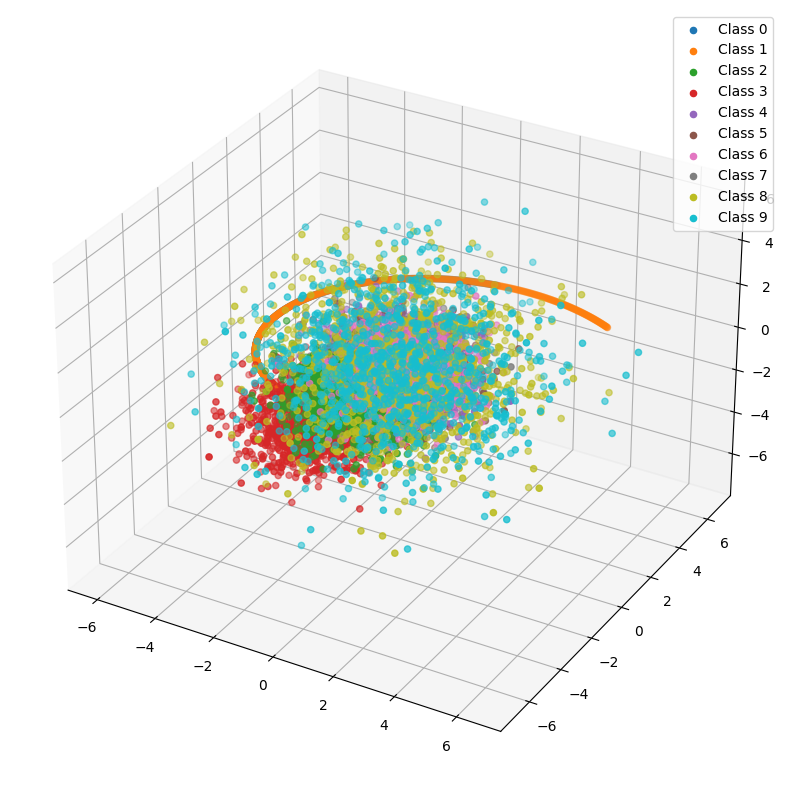

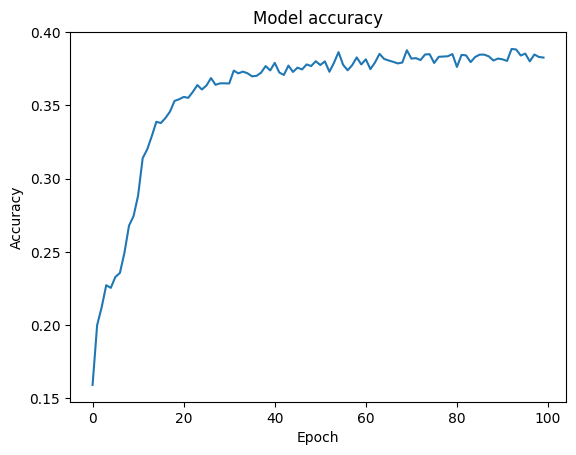

313/313 [==============================] - 0s 1ms/step


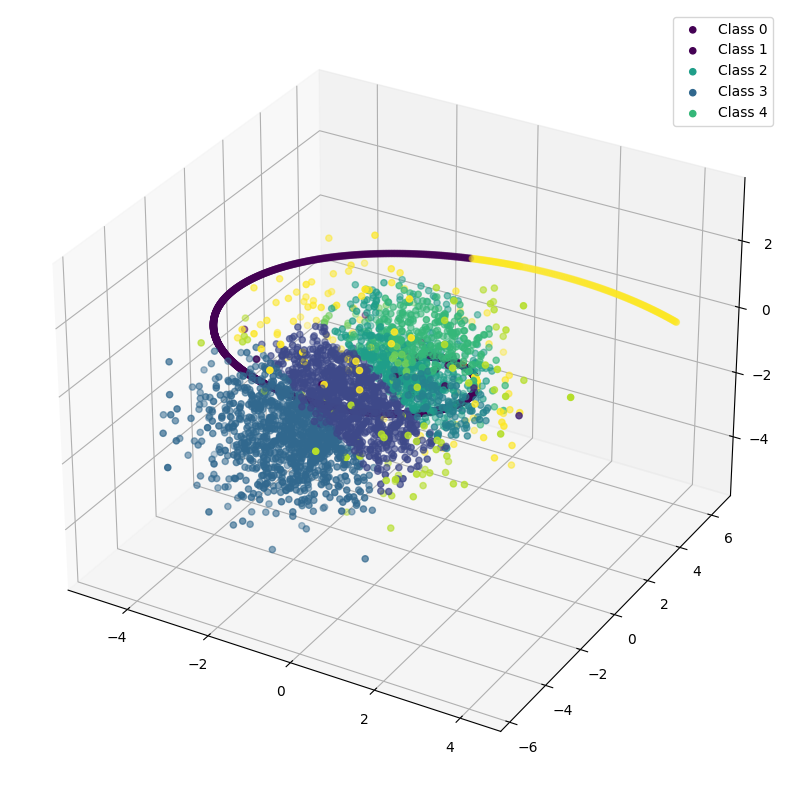

In [ ]:
experiment(2, 32)

In [ ]:
# Main function
def experiment(num_layers=2, neurons_per_layer=32, activation='sigmoid', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

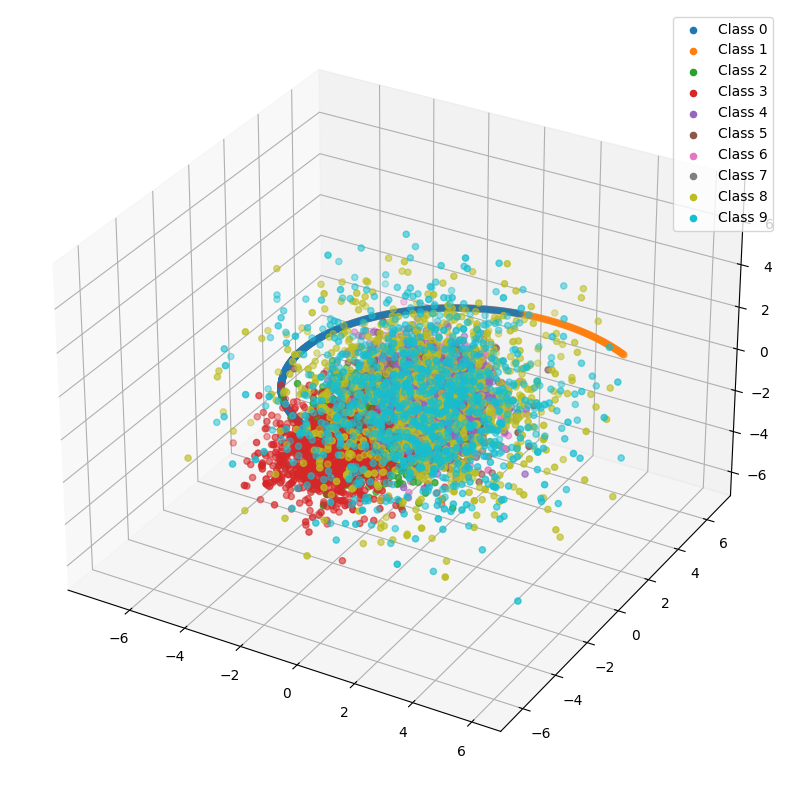

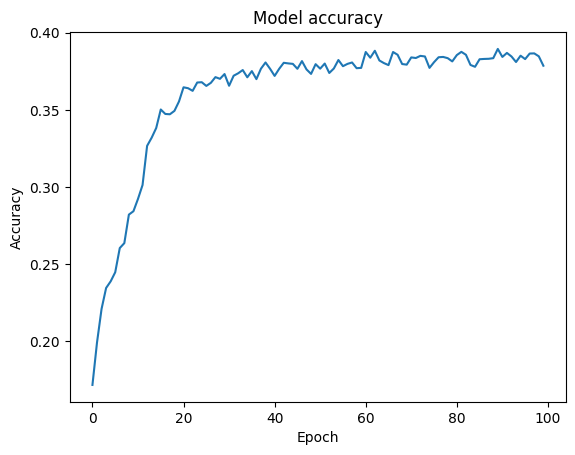

313/313 [==============================] - 1s 2ms/step


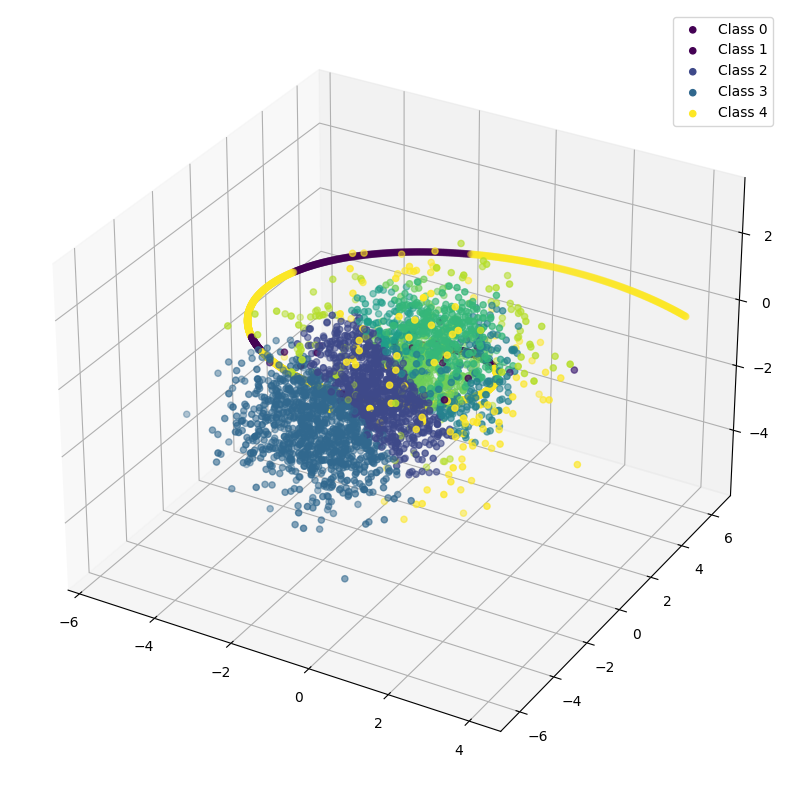

In [ ]:
experiment(2, 32)

In [ ]:
from keras.optimizers import adadelta, adagrad, nadam

In [ ]:
# Main function
def experiment(num_layers=2, neurons_per_layer=32, activation='relu', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

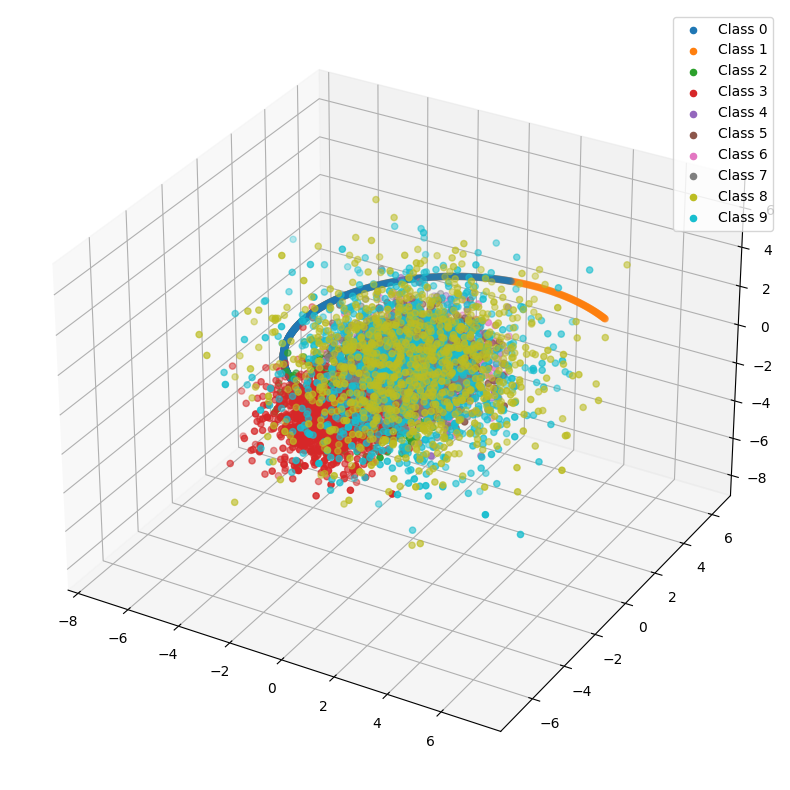

/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


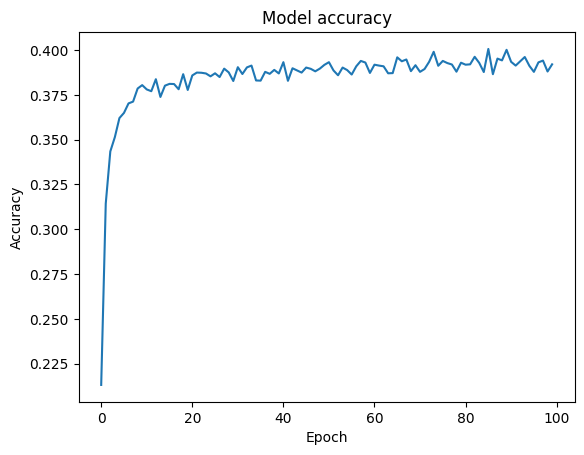

313/313 [==============================] - 0s 1ms/step


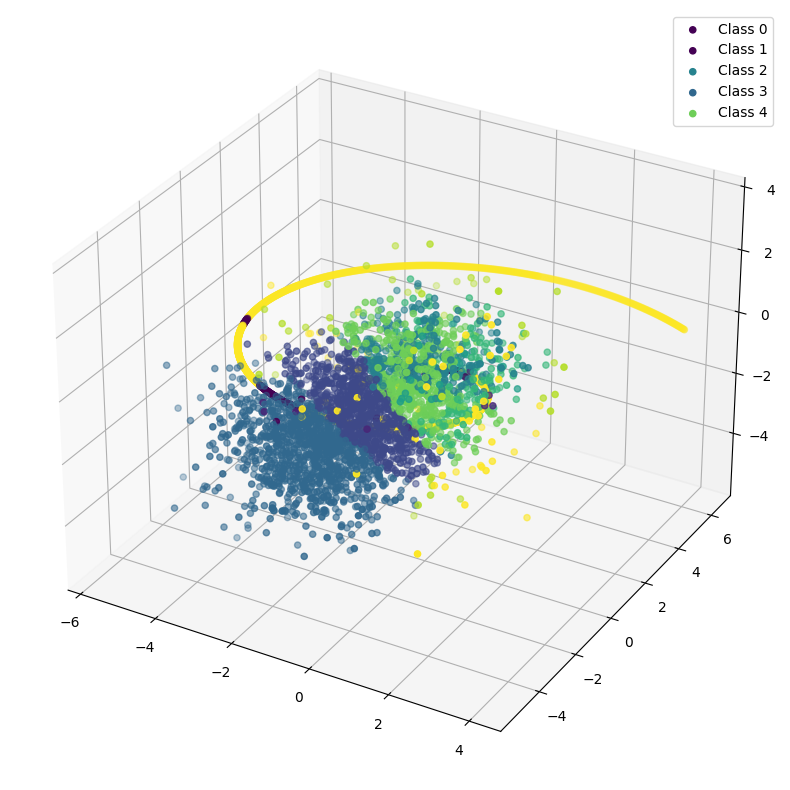

In [ ]:
experiment(2, 32)

In [ ]:
# Main function
def experiment(num_layers=2, neurons_per_layer=32, activation='softmax', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

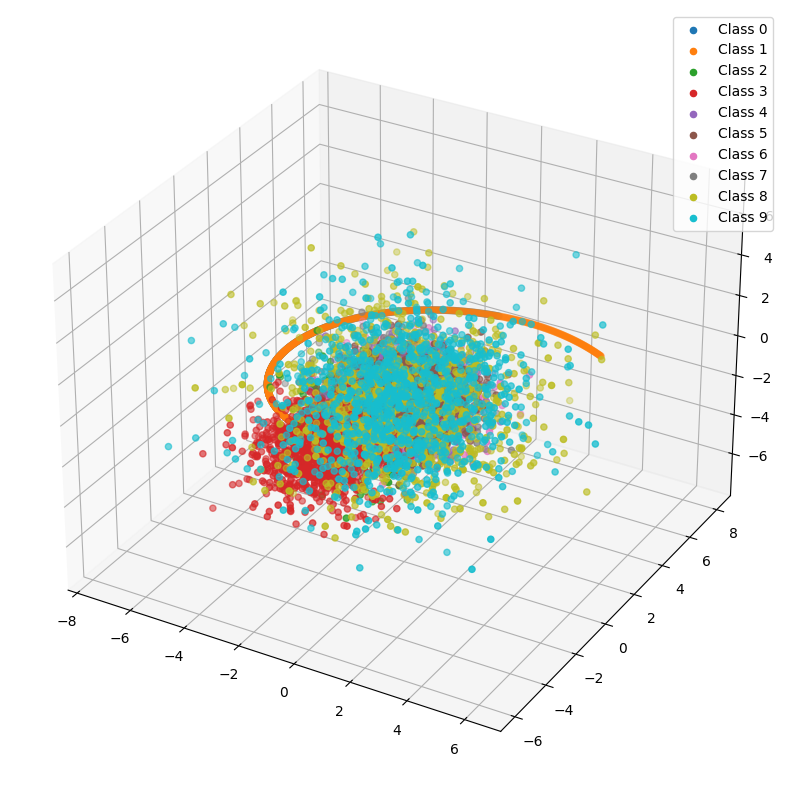

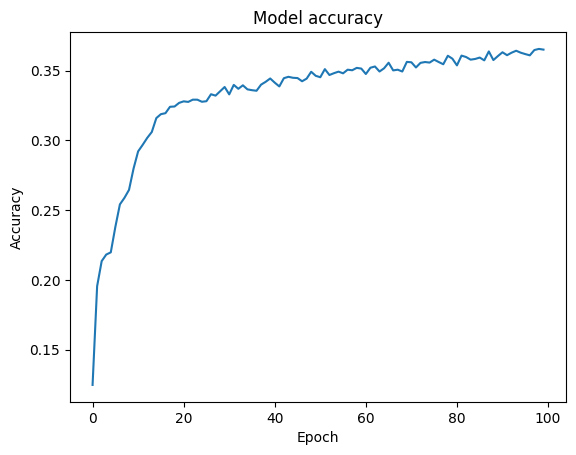

313/313 [==============================] - 0s 1ms/step


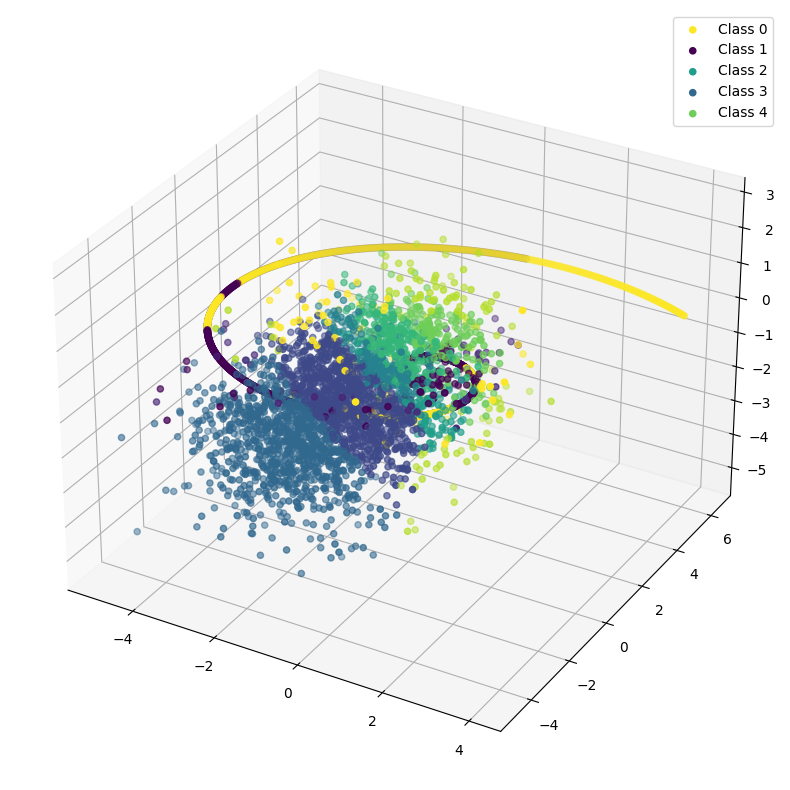

In [ ]:
experiment(2, 32)

In [ ]:
# Main function
def experiment(num_layers=2, neurons_per_layer=32, activation='tanh', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

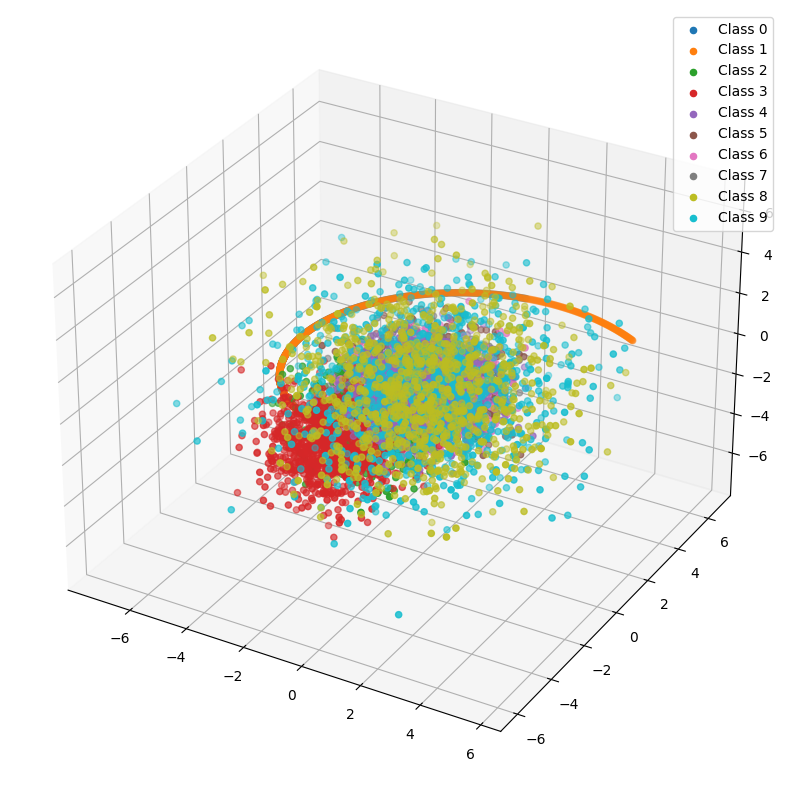

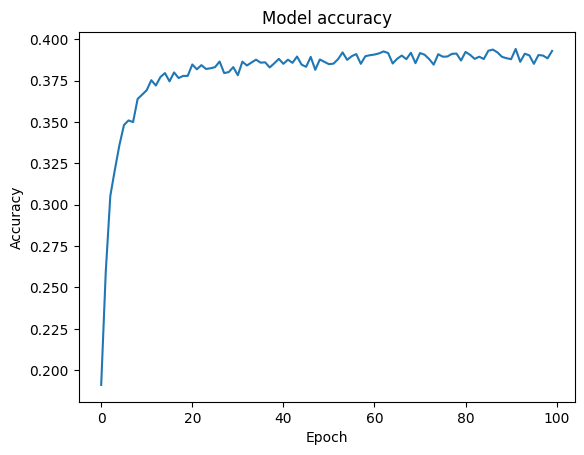

313/313 [==============================] - 1s 3ms/step


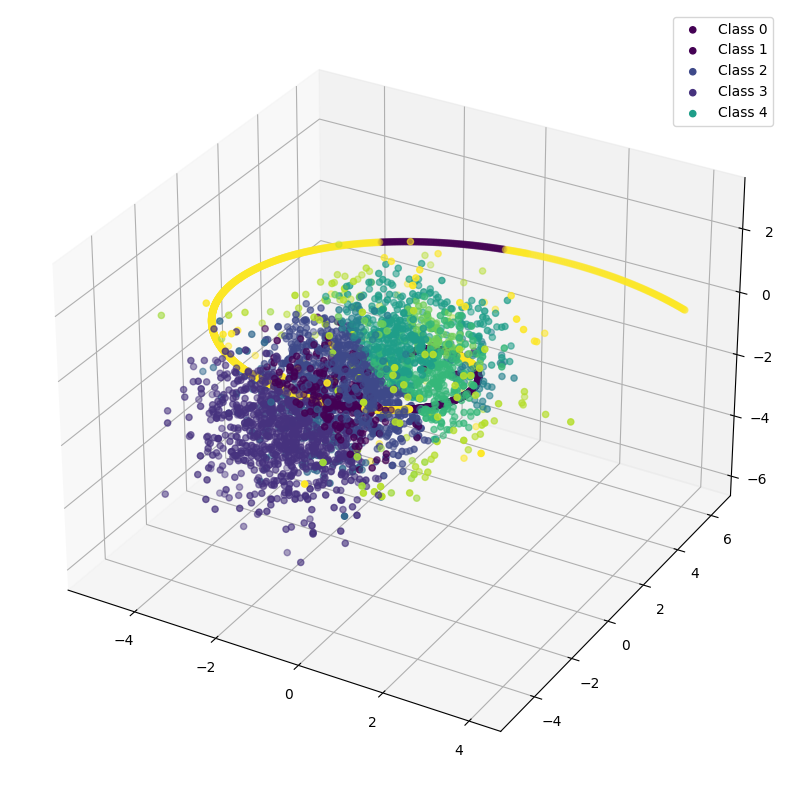

In [ ]:
experiment(2, 32)

In [ ]:
# Main function
def experiment(num_layers=8, neurons_per_layer=128, activation='tanh', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

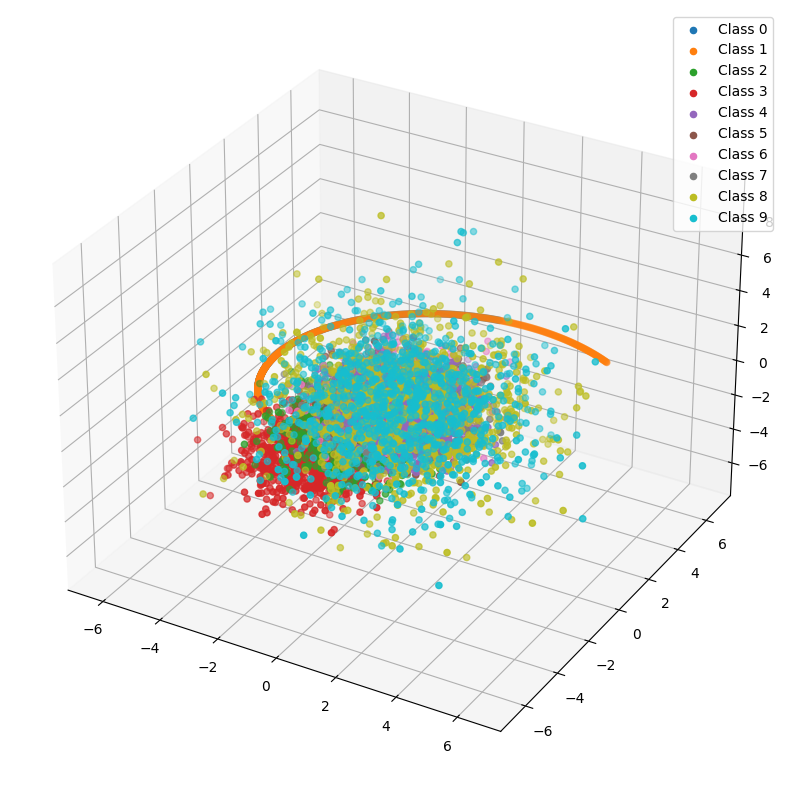

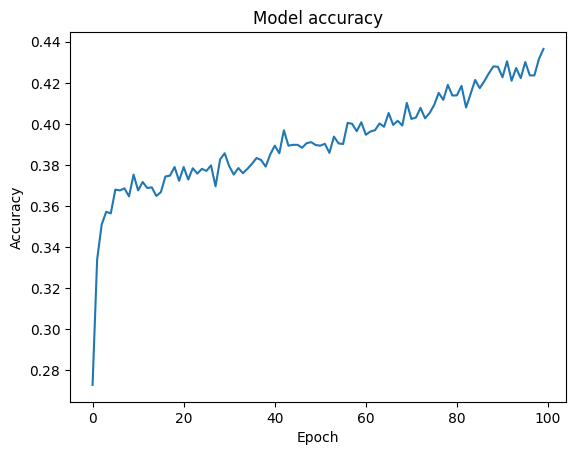

313/313 [==============================] - 1s 2ms/step


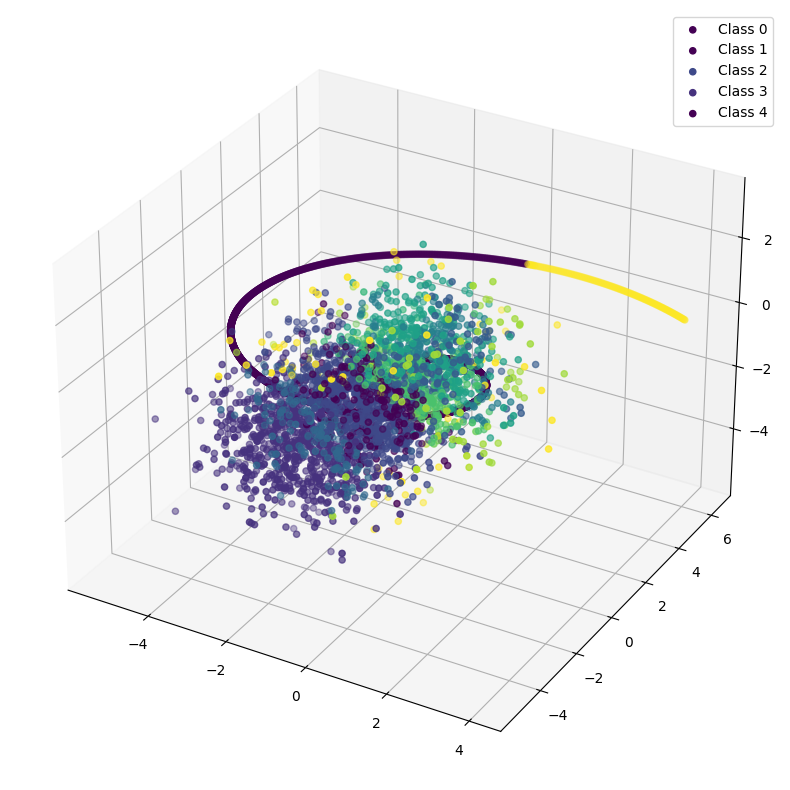

In [ ]:
experiment(8, 128)

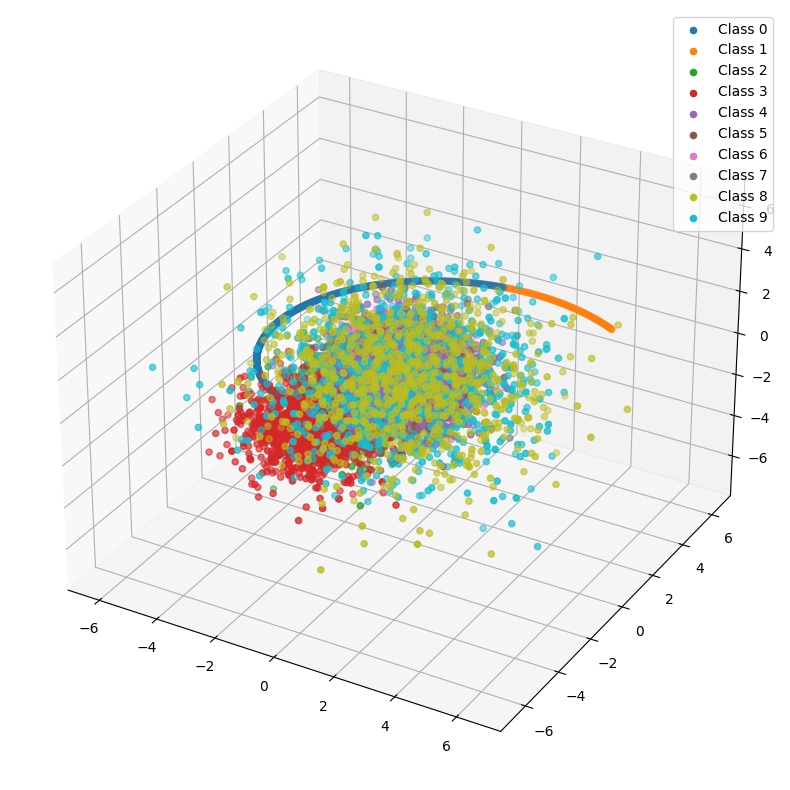

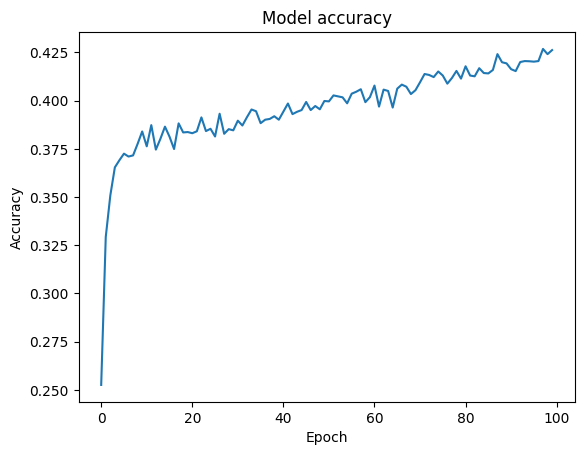

313/313 [==============================] - 0s 1ms/step


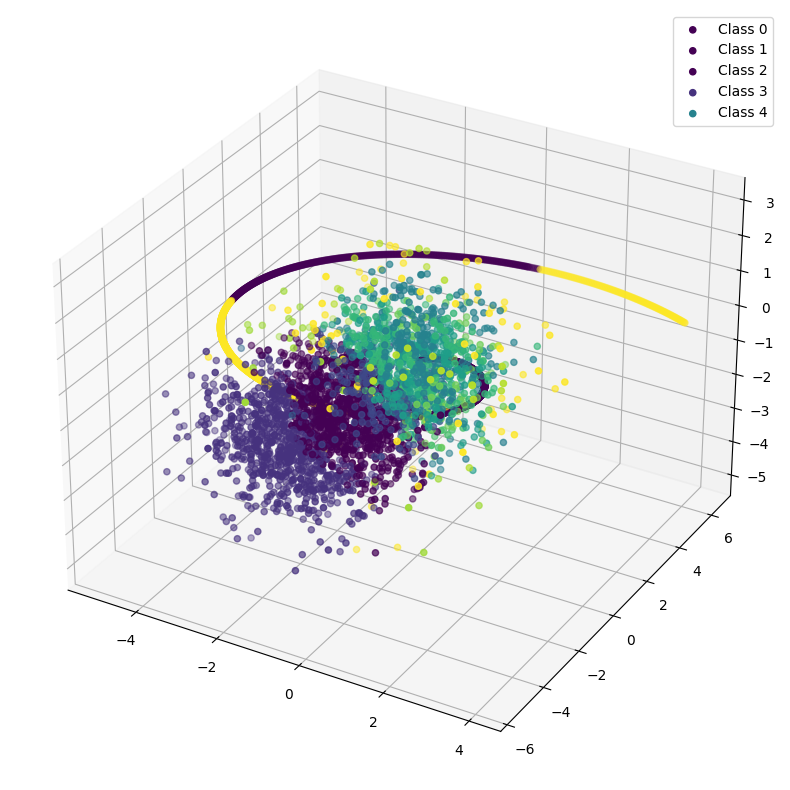

In [ ]:
experiment(4, 64)

In [ ]:
# Main function
def experiment(num_layers=8, neurons_per_layer=256, activation='tanh', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

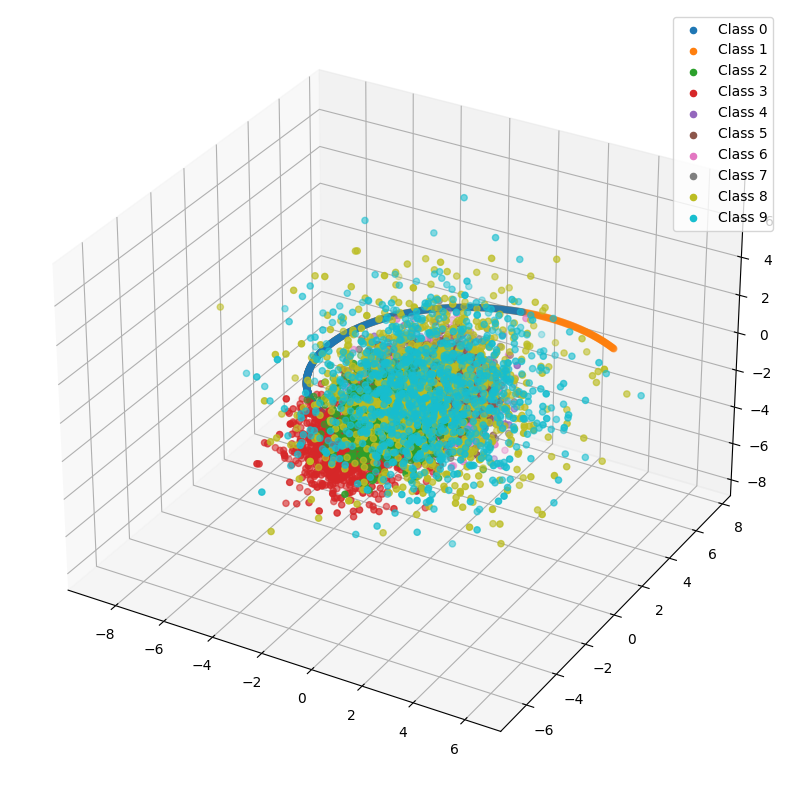

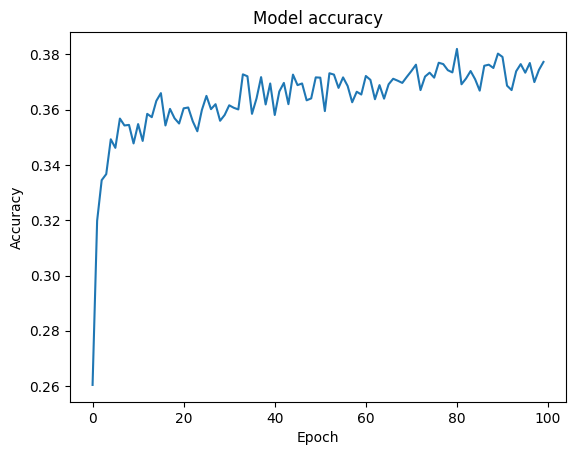

313/313 [==============================] - 1s 3ms/step


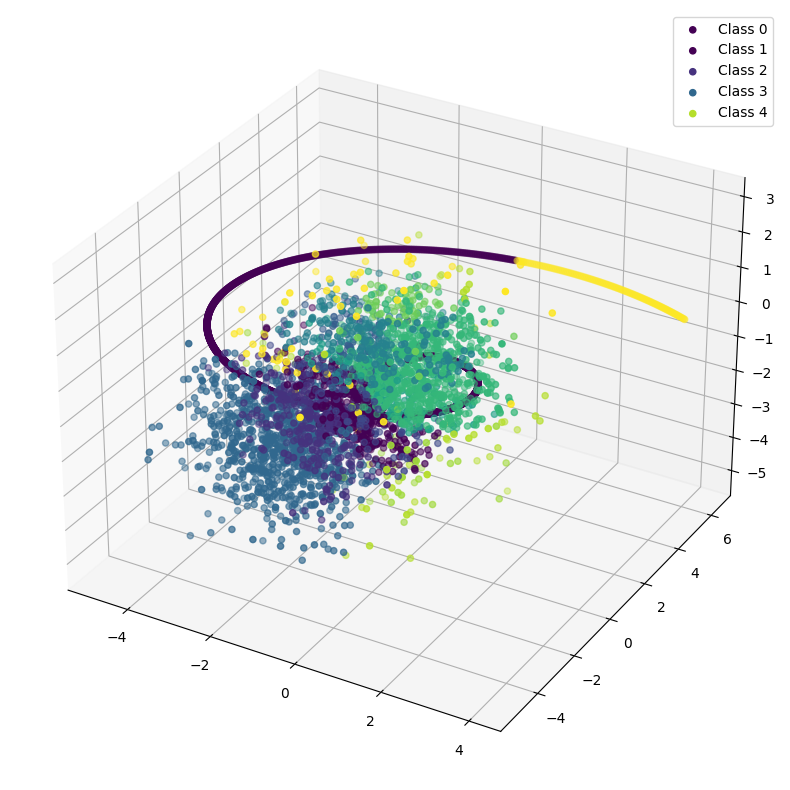

In [ ]:
experiment(8, 256)

In [ ]:
# Main function
def experiment(num_layers=8, neurons_per_layer=128, activation='tanh', epochs=500):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.1)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

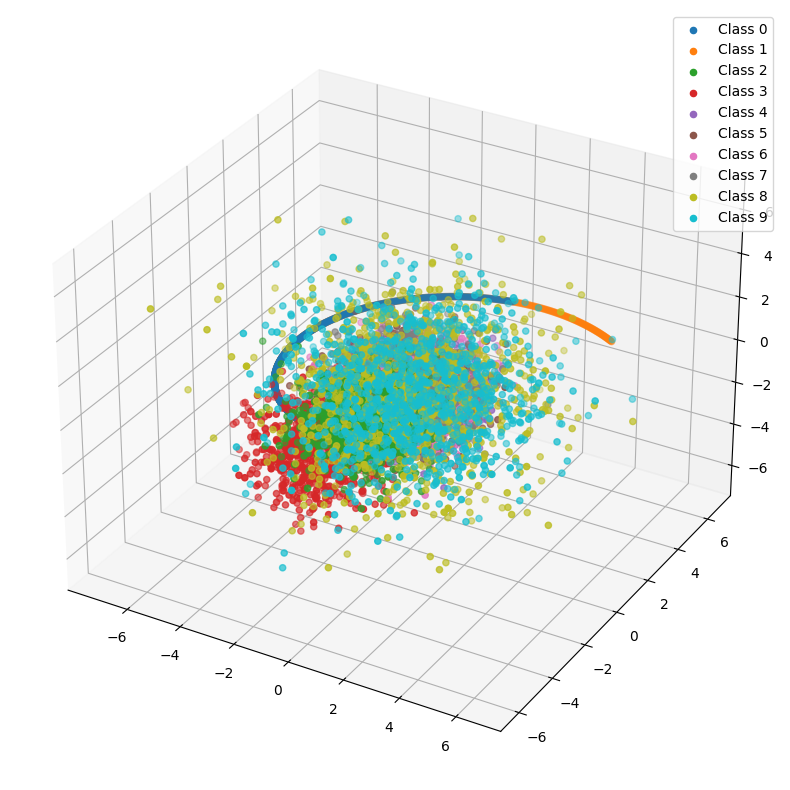

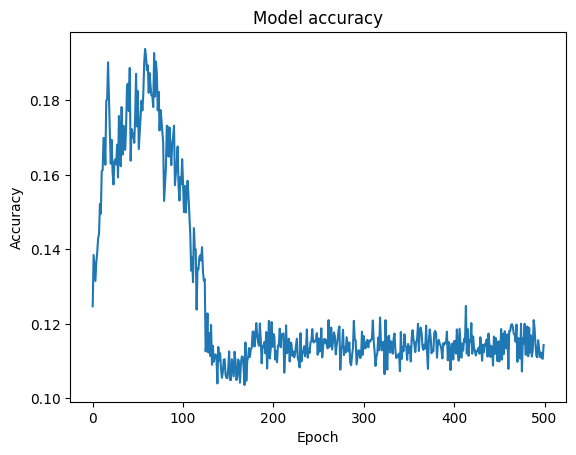

313/313 [==============================] - 1s 2ms/step


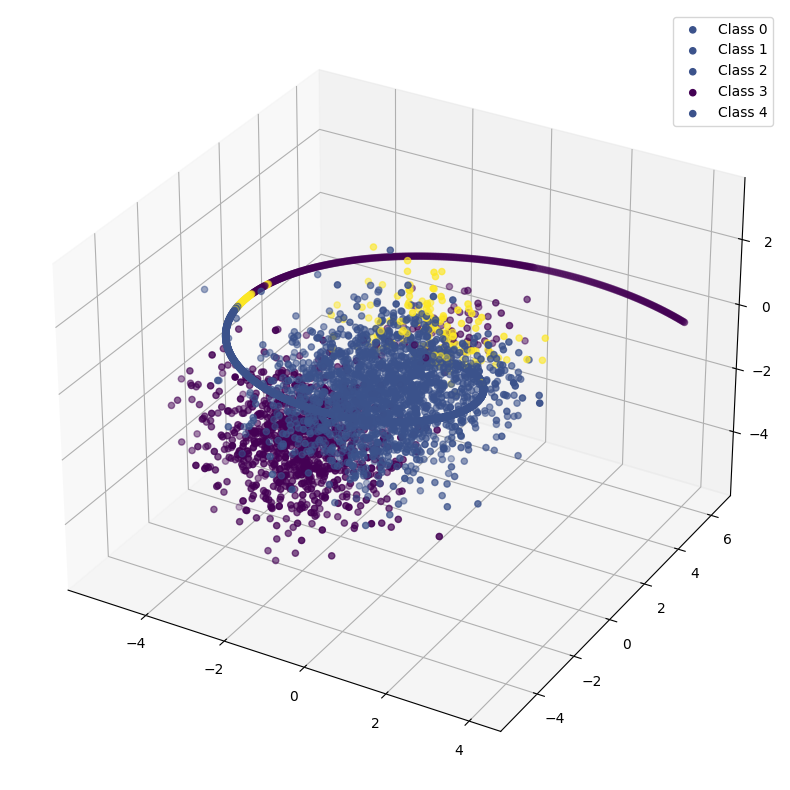

In [ ]:
experiment(8, 128)

In [ ]:
# Main function
def experiment(num_layers=8, neurons_per_layer=128, activation='tanh', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=10)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

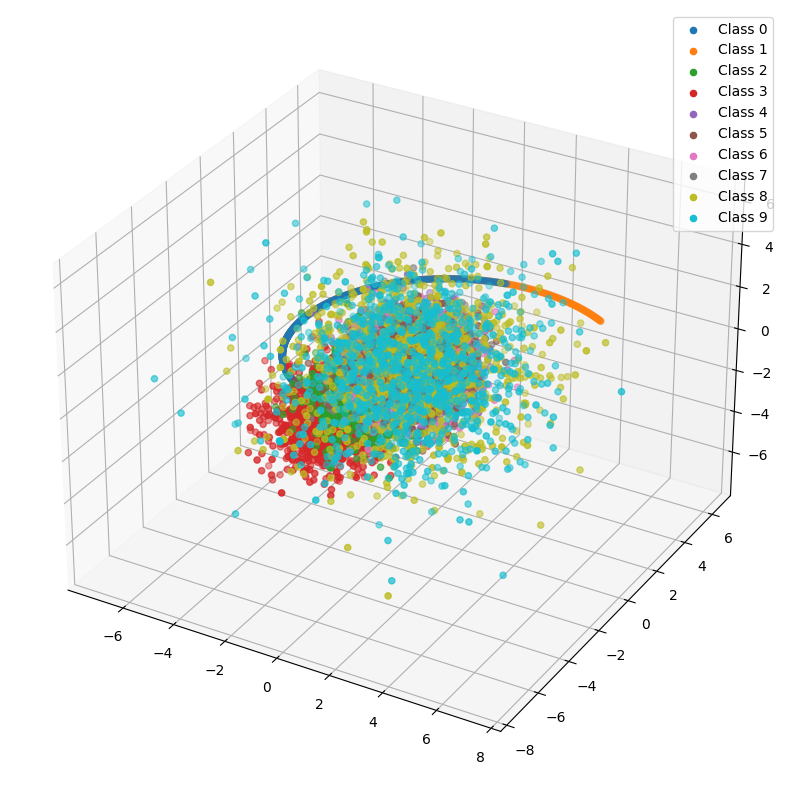

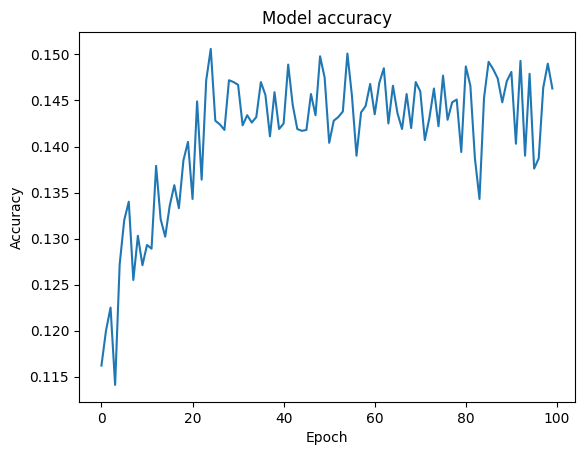

313/313 [==============================] - 1s 2ms/step


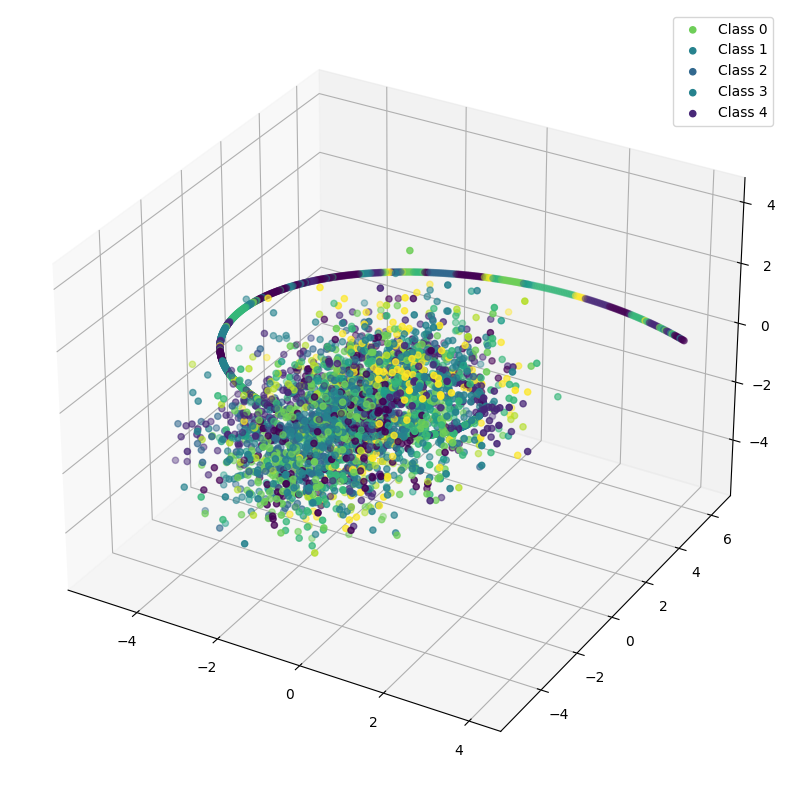

In [ ]:
experiment(8, 128)

In [ ]:
def generate_dataset():
    X = []
    y = []
    means = [[1, 1, 1], [2, 2, 2], [-1, -1, -1], [-2, -2, -2], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0]]
    covs = [[[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]]]
    for i in range(10):
        if i < 2:
            t = np.linspace(0, 2 * np.pi, 1000) + i * np.pi / 5
            x = np.sin(t) * t
            y_ = np.cos(t) * t
            z = np.zeros(1000)  # Add a third dimension filled with zeros
            X_class = np.column_stack((x, y_, z))
        elif i < 4:
            X_class = np.random.multivariate_normal(means[i], covs[i], 1000)
        elif i < 6:
            x, y_, z = np.random.randn(3, 1000)
            X_class = np.column_stack((x, y_, z))
        elif i < 8:
            X_class = np.random.randn(1000, 3)
        else:
            x, y_, z = np.random.randn(3, 1000) * 2
            X_class = np.column_stack((x, y_, z))
        if i == 0:
            X = X_class
            y = np.array([i] * 1000)
        else:
            X = np.concatenate((X, X_class), axis=0)
            y = np.concatenate((y, np.array([i] * 1000)), axis=0)
    return X, y


In [ ]:
# Main function
def experiment(num_layers=8, neurons_per_layer=128, activation='tanh', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=10)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

In [ ]:
def generate_dataset():
    X = []
    y = []
    means = [[3, 3, 3], [5, 5, 5], [7, 7, 7], [9, 9, 9], [1, 1, 1], [2, 2, 2], [4, 4, 4], [6, 6, 6], [8, 8, 8], [0, 0, 0]]
    covs = [[[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]], [[1, 0, 0], [0, 1, 0], [0, 0, 1]],
            [[1, 0, 0], [0, 1, 0], [0, 0, 1]]]
    for i in range(10):
        X_class = np.random.multivariate_normal(means[i], covs[i], 25)
        X.extend(X_class)
        y.extend([i] * 25)
    return np.array(X), np.array(y)


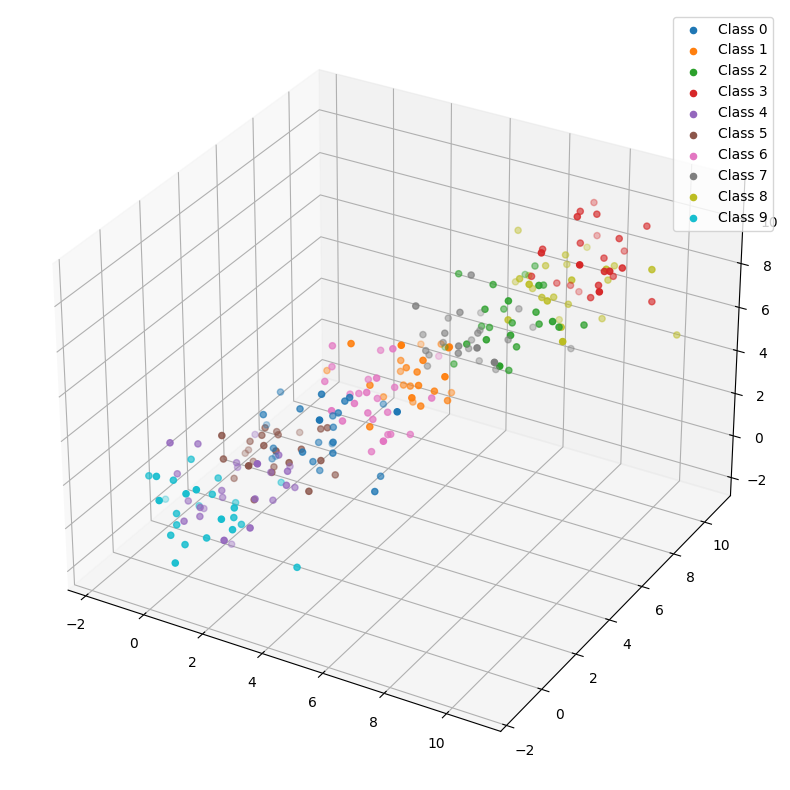

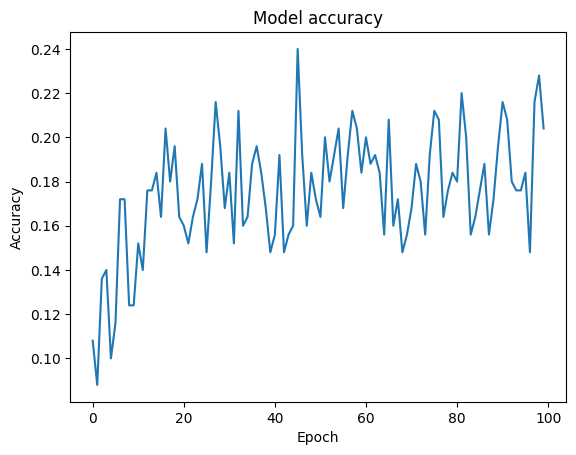

8/8 [==============================] - 0s 2ms/step


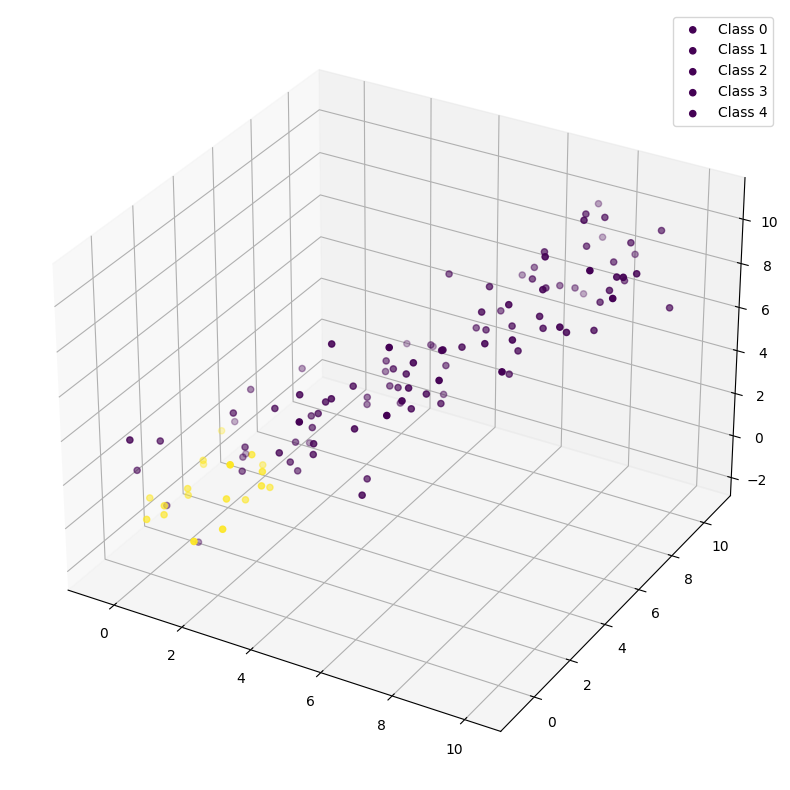

In [ ]:
experiment(8, 128)

In [ ]:
# Main function
def experiment(num_layers=8, neurons_per_layer=128, activation='tanh', epochs=500):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.1)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

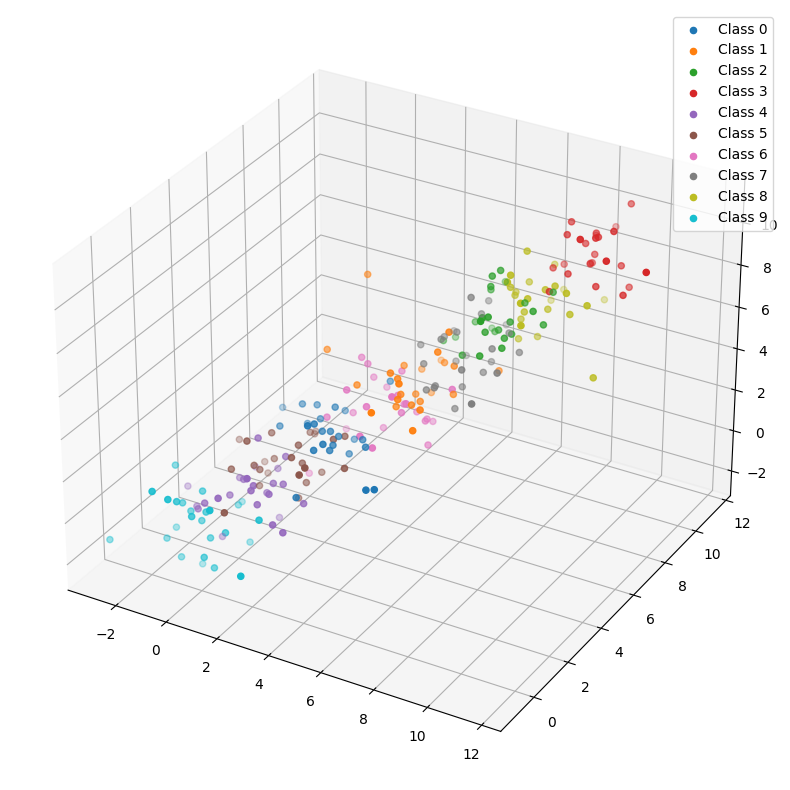

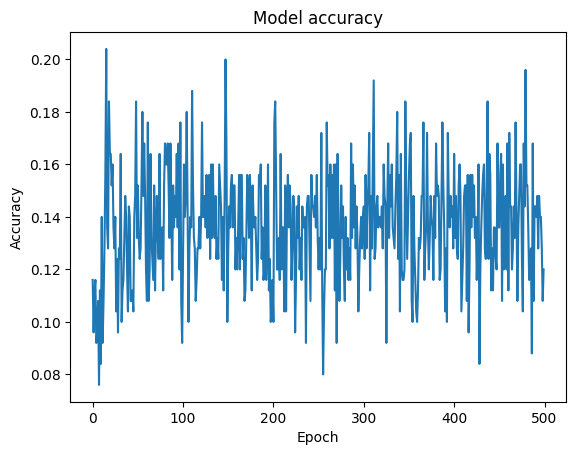

8/8 [==============================] - 0s 2ms/step


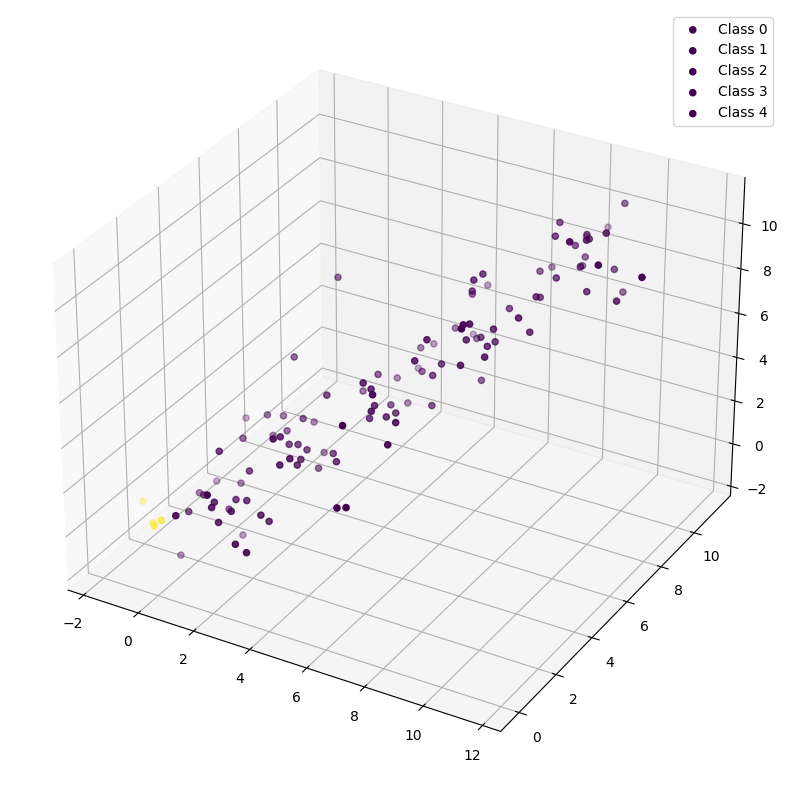

In [ ]:
experiment(8, 128)

In [ ]:
# Main function
def experiment(num_layers=8, neurons_per_layer=256, activation='tanh', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

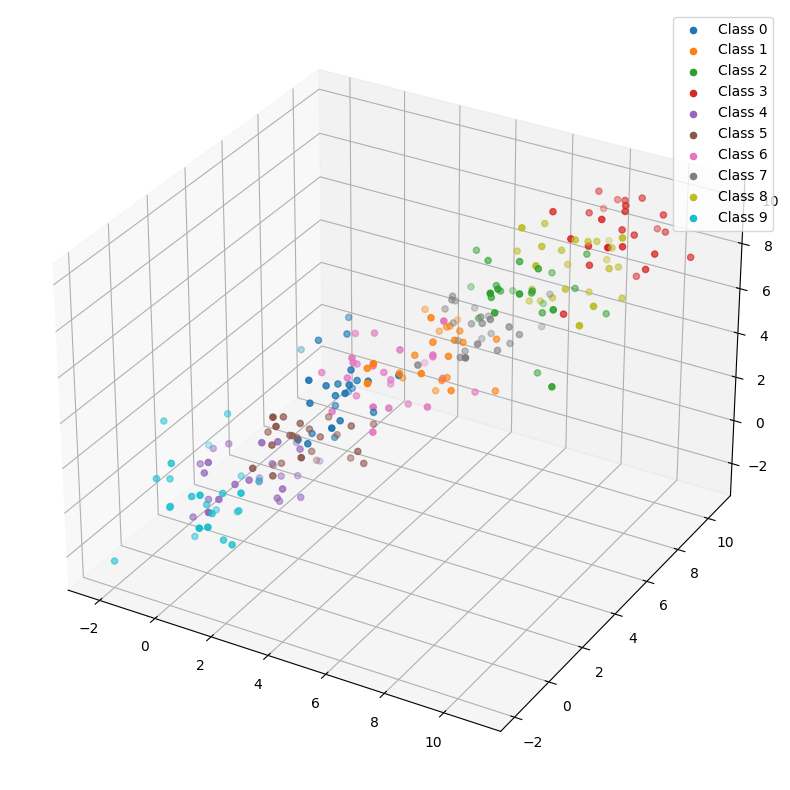

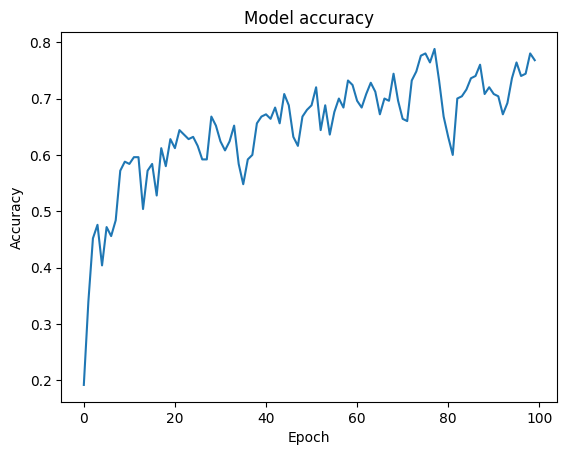

8/8 [==============================] - 0s 4ms/step


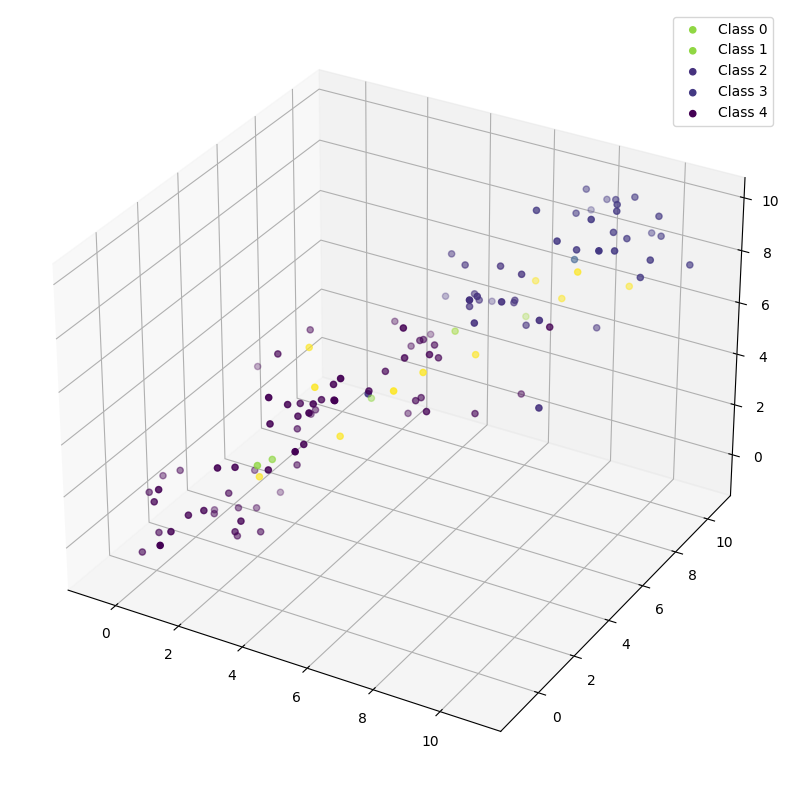

In [ ]:
experiment(8, 256)

In [ ]:
# Main function
def experiment(num_layers=8, neurons_per_layer=128, activation='tanh', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=3)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)

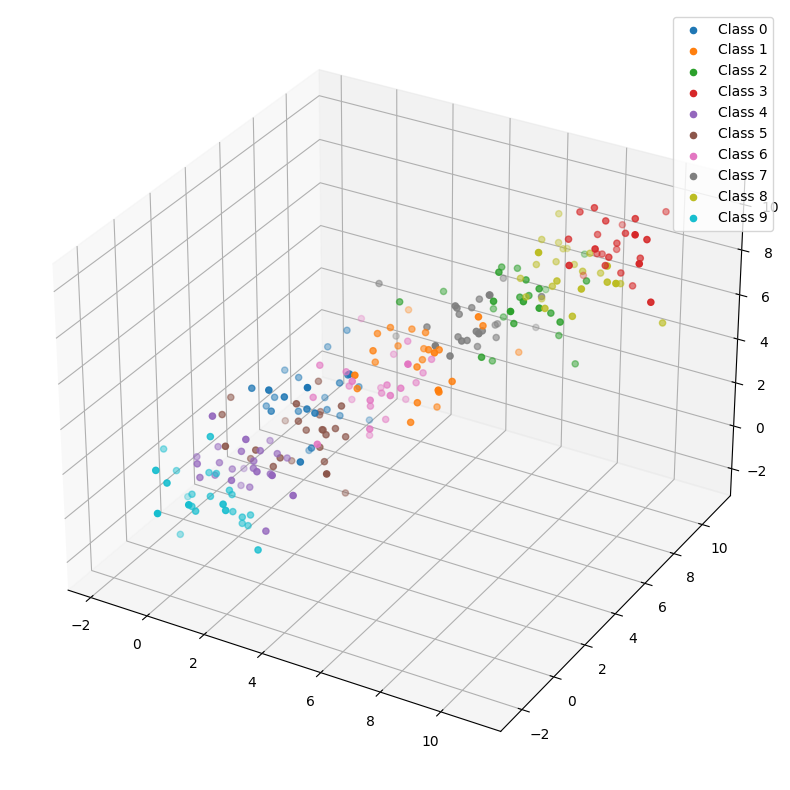

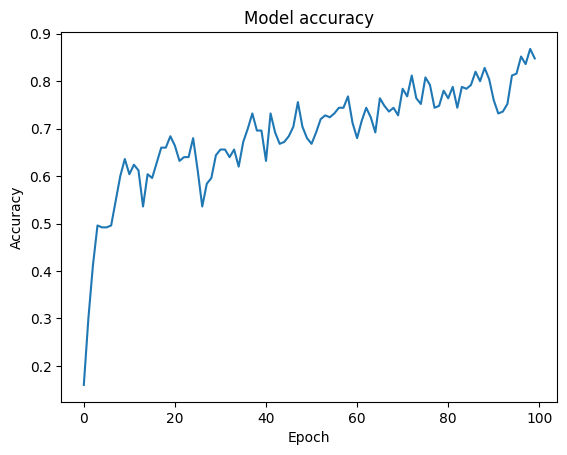

8/8 [==============================] - 0s 3ms/step


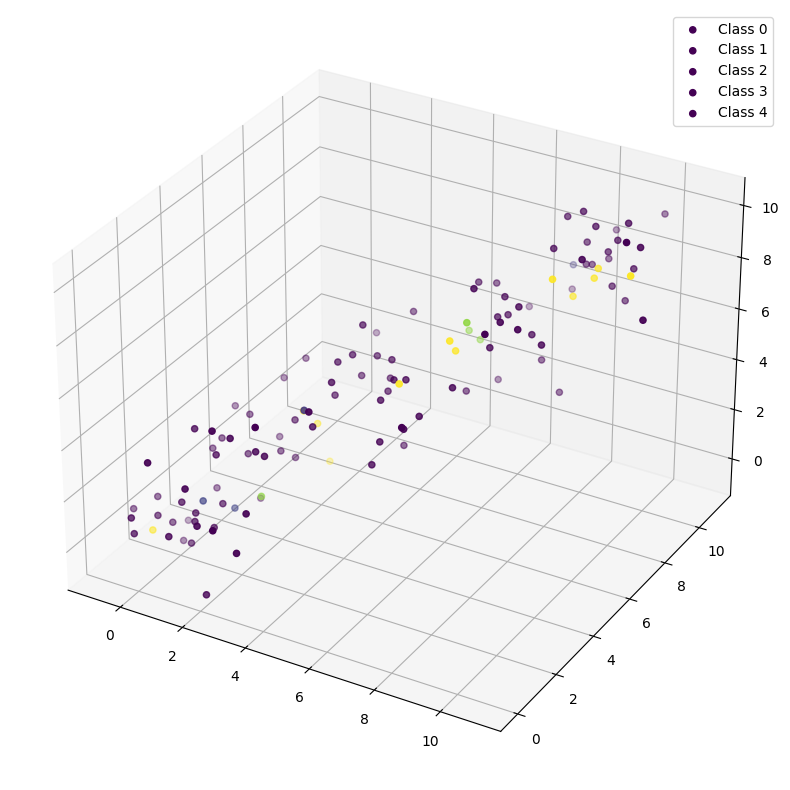

In [ ]:
experiment(8, 128)

Zbiór Gaussa (czyli dane wygenerowane za pomocą rozkładu Gaussa, zwanego też rozkładem normalnym) ma pewne właściwości, które mogą ułatwiać trening sieci:


Rozkład danych
Dane wygenerowane przy użyciu rozkładu Gaussa cechują się określonym kształtem, gdzie większość punktów skupia się wokół średniej wartości, a ich rozproszenie jest kontrolowane przez odchylenie standardowe. Ta regularność ułatwia proces uczenia sieci neuronowych, ponieważ dane posiadają bardziej przewidywalne wzorce.

Normalizacja
Warto zaznaczyć, że dane wygenerowane z rozkładu Gaussa są często już znormalizowane, co oznacza, że mają średnią wartość równą 0 i odchylenie standardowe równa 1. To korzystne dla treningu sieci neuronowych, ponieważ eliminuje to problemy związane z różnicami w skali między różnymi cechami, co może utrudniać proces uczenia.

Outliery (wartości odstające)
W rozkładzie Gaussa, wartości odstające są rzadko spotykane. Niemniej jednak, w zestawach danych generowanych losowo, mogą pojawić się wartości odstające, które stanowią wyjątkowo wysokie lub niskie obserwacje. Te wartości odstające mogą zakłócić proces uczenia sieci neuronowych i wymagają specjalnych strategii, aby zostać zidentyfikowane i przetworzone.

Liniowość
W kontekście problemów klasyfikacji, dane pochodzące z rozkładu Gaussa często są liniowo separowalne, co oznacza, że można je oddzielić za pomocą prostych linii lub hiperpłaszczyzn (w przypadku wielu wymiarów). To właśnie dlatego sieci neuronowe skutecznie radzą sobie z takimi danymi, ponieważ mogą dostosować swoje parametry (wagi i biasy) w taki sposób, aby znaleźć odpowiednią granicę decyzyjną. Jednak w przypadku bardziej skomplikowanych danych, które nie są liniowo separowalne, konieczne może być zastosowanie zaawansowanych architektur sieci lub technik przetwarzania danych.

2. Wpływ Architektury Sieci na Jakość Klasyfikacji
Badania empiryczne wykazują, że architektura sieci neuronowej ma istotny wpływ na jakość klasyfikacji. Zwiększenie liczby warstw w modelu może prowadzić do poprawy wyników, jednak istnieje pewien punkt, po którym dodawanie kolejnych warstw może skutkować nadmiernymi fluktuacjami w procesie uczenia. Wyniki analiz sugerują, że optymalna architektura sieci składa się z ośmiu warstw, z każdą z nich zawierającą 128 neuronów.

3. Wpływ Szybkości Trenowania na Jakość Klasyfikacji
Szybkość uczenia ma wyraźny wpływ na jakość procesu klasyfikacji w sieciach neuronowych. Eksperymenty wykazały, że zbyt wysoka wartość współczynnika uczenia może prowadzić do większych fluktuacji w procesie uczenia, co objawia się większymi oscylacjami na wykresie funkcji strat. Dlatego ważne jest dobranie odpowiedniego tempo uczenia, aby osiągnąć stabilność i efektywność procesu uczenia.

4. Wpływ Wyboru Optymalizatora na Jakość Klasyfikacji
Wybór optymalizatora ma znaczący wpływ na jakość procesu klasyfikacji w uczeniu maszynowym. Wyniki analiz wskazują, że optymalizator Adam, który opiera się na adaptacyjnym estymowaniu momentów, jest jednym z najbardziej efektywnych narzędzi w tym kontekście. Dzięki jego zdolności do szybkiej konwergencji i mniejszej wrażliwości na początkowy wskaźnik uczenia, optymalizator Adam jest często preferowanym wyborem w wielu aplikacjach uczenia maszynowego.

In [ ]:
def generate_dataset():
    X = []
    y = []
    for i in range(5):
        t = np.linspace(0, 2 * np.pi, 1000) + i * np.pi / 5
        x = np.sin(t) * t
        y_ = np.cos(t) * t
        X_class = np.column_stack((x, y_))
        if i == 0:
            X = X_class
            y = np.array([i] * 1000)
        else:
            X = np.concatenate((X, X_class), axis=0)
            y = np.concatenate((y, np.array([i] * 1000)), axis=0)
    return X, y

def plot_dataset(X, y):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    for i in range(5):
        X_class = X[y == i]
        ax.scatter(X_class[:, 0], X_class[:, 1], label='Class {}'.format(i))
    ax.legend()
    plt.show()

def plot_classification_results(X, y, model):
    y_probs = model.predict(X)
    y_pred = np.argmax(y_probs, axis=1)
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    for i in range(5):
        X_class = X[y == i]
        y_pred_class = y_pred[y == i]
        X_class_3d = np.column_stack((X_class, np.zeros(len(X_class)))) # add a third dimension
        ax.scatter(X_class_3d[:, 0], X_class_3d[:, 1], X_class_3d[:, 2], c=y_pred_class,
                   label='Class {}'.format(i))
    ax.legend()
    plt.show()

# Main function
def experiment(num_layers=3, neurons_per_layer=32, activation='relu', epochs=100):
    X, y = generate_dataset()
    plot_dataset(X, y)

    classifier = Classifier(num_layers, neurons_per_layer, activation)
    model = classifier.build_model(input_shape=2)

    optimizer = Adam(lr=0.001)
    history = train(X, y, model, optimizer, epochs)
    plot_history(history)

    plot_classification_results(X, y, model)